This version has all three outputs, calculates strain (ezz) and uses a mask input.

In [ ]:
#importing the libraries used
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tifffile as tiff
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.models import Model
from scipy.ndimage import zoom
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Dropout, concatenate, BatchNormalization, Multiply, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.callbacks import ModelCheckpoint
from keras.regularizers import l2, l1
from scipy.ndimage import binary_dilation, binary_erosion
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.gridspec as gridspec

%matplotlib inline

2024-03-13 22:57:14.184514: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-13 22:57:14.184633: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-13 22:57:14.352391: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


<h1>Importing the Image Data</h1>

In [ ]:
# Define directory paths
trainPath = '/data/Input/Scan'
maskPath = '/data/Input/Mask'
testPathU = '/data/Target/U'
testPathV = '/data/Target/V'
testPathW = '/data/Target/W'

#Define function to import images
def import_images(folder_path, name):
    image_data_list = []
    file_path = os.path.join(folder_path, name)
    img = tiff.imread(file_path)
    img[np.isnan(img)] = 0
    image_data_list.append(img)
    return image_data_list

# Get the list of files in testPathU (this was chosen generically as files in all directories have the same name)
test_u_files = set([f for f in os.listdir(testPathU) if os.path.isfile(os.path.join(testPathU, f))])

#Import all images into the bone_data array
# Note, the train images have had some poor images removed manually where there was not enough bone.
# This function will only import images (from all folders) if they exist in the trainPath

bone_data = [[], [], [], [], []]
for file in os.listdir(trainPath):
    if file in test_u_files:
        bone_data[0].extend(import_images(trainPath, file))
        bone_data[1].extend(import_images(maskPath, file))
        bone_data[2].extend(import_images(testPathU, file))
        bone_data[3].extend(import_images(testPathV, file))
        bone_data[4].extend(import_images(testPathW, file))

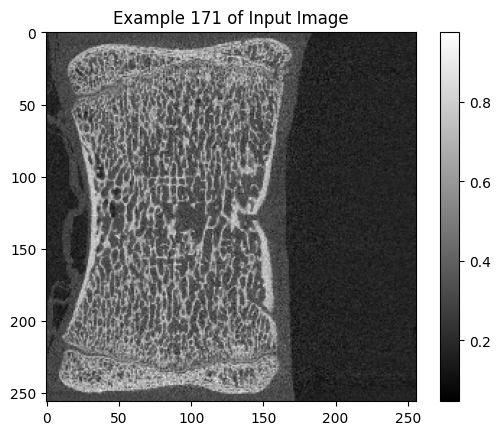

In [ ]:
# Import the Scan slices
common_shape = (256, 256)

resized_image_data = []
for img in bone_data[0]:
    resized_img = zoom(img, (common_shape[0] / img.shape[0], common_shape[1] / img.shape[1]), mode='nearest', order=0)
    resized_image_data.append(resized_img)

scan = np.array(resized_image_data)
scan = scan/255

# Plot an example of the output image
example_index = 170
# You can change this to plot different examples
plt.imshow(scan[example_index], cmap='gray')
plt.title(f"Example {example_index+1} of Input Image")
plt.colorbar()
plt.show()

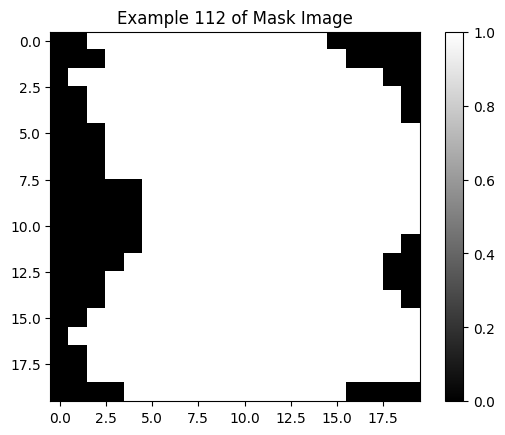

In [ ]:
# Import the mask slices
common_shape = (20, 20)
resized_image_data = []

for img in bone_data[1]:
    resized_img = zoom(img, (common_shape[0] / img.shape[0], common_shape[1] / img.shape[1]), order=0, grid_mode=False)
    resized_image_data.append(resized_img)

mask = np.array(resized_image_data)

# Perform binary dilation on the mask
mask = binary_dilation(mask)

# Plot an example of the output image
example_index = 111  # You can change this to plot different examples
plt.imshow(mask[example_index], cmap='gray')
plt.title(f"Example {example_index+1} of Mask Image")
plt.colorbar()
plt.show()

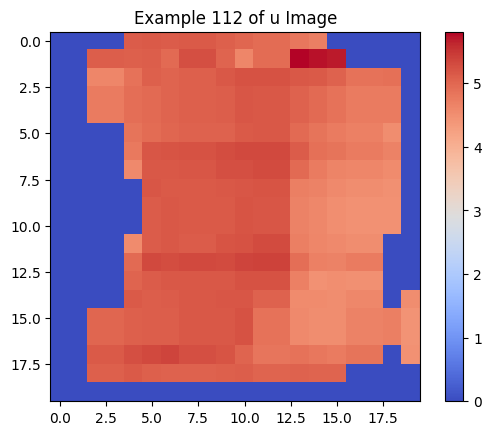

In [ ]:
# Import the u target
common_shape = (20, 20)

resized_image_data = []
for img in bone_data[2]:
    resized_img = zoom(img, (common_shape[0] / img.shape[0], common_shape[1] / img.shape[1]), mode='nearest', order=0)
    resized_image_data.append(resized_img)
# Convert the list of resized images into a NumPy array
output_ims_u = np.array(resized_image_data)


# Plot an example of the output image
example_index = 111  # You can change this to plot different examples
plt.imshow(output_ims_u[example_index], cmap='coolwarm')
plt.title(f"Example {example_index+1} of u Image")
plt.colorbar()
plt.show()

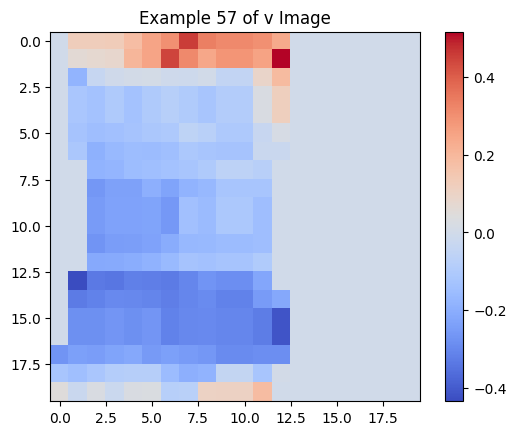

In [ ]:
# Import the v target
common_shape = (20, 20)

resized_image_data = []
for img in bone_data[3]:
    resized_img = zoom(img, (common_shape[0] / img.shape[0], common_shape[1] / img.shape[1]), mode='nearest', order=0)
    resized_image_data.append(resized_img)

# Convert the list of resized images into a NumPy array
output_ims_v = np.array(resized_image_data)

# Plot an example of the output image
example_index = 56  # You can change this to plot different examples
plt.imshow(output_ims_v[example_index], cmap='coolwarm')
plt.title(f"Example {example_index+1} of v Image")
plt.colorbar()
plt.show()

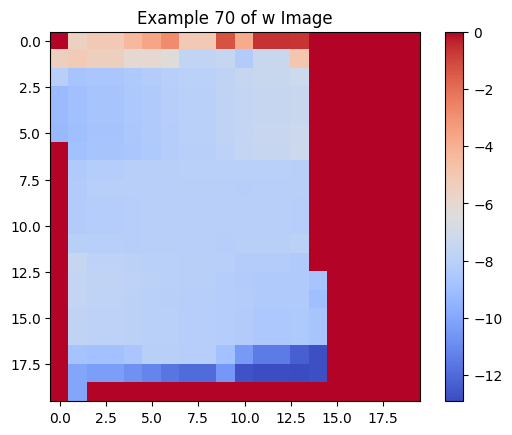

In [ ]:
# Import the w target
common_shape = (20, 20)

resized_image_data = []
for img in bone_data[4]:
    resized_img = zoom(img, (common_shape[0] / img.shape[0], common_shape[1] / img.shape[1]), mode='nearest', order=0)
    resized_image_data.append(resized_img)

# Convert the list of resized images into a NumPy array
output_ims_w = np.array(resized_image_data)

# Plot an example of the output image
example_index = 69  # You can change this to plot different examples
plt.imshow(output_ims_w[example_index], cmap='coolwarm')
plt.title(f"Example {example_index+1} of w Image")
plt.colorbar()
plt.show()

<h1>Split the Data</h1>

In [ ]:
# Random Seed
RS = 3623

# displacements
target_NT_u, target_test_u = train_test_split(output_ims_u, test_size=0.1, random_state=RS, shuffle=True)
target_train_u, target_val_u = train_test_split(target_NT_u, test_size=1/9, random_state=RS, shuffle=True)
target_NT_v, target_test_v = train_test_split(output_ims_v, test_size=0.1, random_state=RS, shuffle=True)
target_train_v, target_val_v = train_test_split(target_NT_v, test_size=1/9, random_state=RS, shuffle=True)
target_NT_w, target_test_w = train_test_split(output_ims_w, test_size=0.1, random_state=RS, shuffle=True)
target_train_w, target_val_w = train_test_split(target_NT_w, test_size=1/9, random_state=RS, shuffle=True)

# scans
input_NT, input_test_1 = train_test_split(scan, test_size=0.1, random_state=RS, shuffle=True)
input_train_1, input_val_1 = train_test_split(input_NT, test_size=1/9, random_state=RS, shuffle=True)

# Masks
input_NT, input_test_2 = train_test_split(mask, test_size=0.1, random_state=RS, shuffle=True)
input_train_2, input_val_2 = train_test_split(input_NT, test_size=1/9, random_state=RS, shuffle=True)

<h1>Create & Train CNN</h1>

In [ ]:
from tensorflow.keras.layers import Layer, Input, Conv2D, BatchNormalization, MaxPooling2D, Dropout, Flatten, Dense, Multiply

def create_cnn(input_shape1, input_shape2, output_shape, dropout_rate, l2_lambda):
    input_layer1 = Input(shape=input_shape1)
    input_layer2 = Input(shape=input_shape2)

    x = input_layer1
    # Convolutional layers for the first image
    x = BatchNormalization()(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = BatchNormalization()(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(dropout_rate)(x)

    x = Flatten()(x)
    x = Dropout(dropout_rate)(x)
    x = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x = Dropout(dropout_rate)(x)
    x = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x = Dropout(dropout_rate)(x)

    x = BatchNormalization()(x)
    x_u = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x_u = Dropout(dropout_rate)(x_u)

    x_v = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x_v = Dropout(dropout_rate)(x_v)

    x_w = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x_w = Dropout(dropout_rate)(x_w)

    x_u = Dense(output_shape[0] * output_shape[1], activation=None)(x_u)
    x_v = Dense(output_shape[0] * output_shape[1], activation=None)(x_v)
    x_w = Dense(output_shape[0] * output_shape[1], activation=None)(x_w)

    xm2 = Flatten()(input_layer2)
    output_layer_u = Multiply(name="out_u")([x_u, xm2])
    output_layer_v = Multiply(name="out_v")([x_v, xm2])
    output_layer_w = Multiply(name="out_w")([x_w, xm2])

    model = Model(inputs=[input_layer1, input_layer2], outputs=[output_layer_u, output_layer_v, output_layer_w])
    return model




# Define input shapes and output shape
input_shape1 = (input_train_1.shape[1], input_train_1.shape[2], 1)
input_shape2 = (input_train_2.shape[1], input_train_2.shape[2], 1)
output_shape = (target_train_u.shape[1], target_train_u.shape[2])

# Define regularisation and create the model
dropout_rate = 0.5
l2_lambda = 0.001
model = create_cnn(input_shape1, input_shape2, output_shape, dropout_rate, l2_lambda)
model.summary()

# Compile the model
model.compile(optimizer='adam', loss={'out_u': 'mean_squared_error', 'out_v': 'mean_squared_error', 'out_w': 'mean_squared_error'})

# Reshape input and target data
num_channels = 1
input_data1 = input_train_1.reshape(input_train_1.shape[0], input_train_1.shape[1], input_train_1.shape[2], num_channels)
input_data_val1 = input_val_1.reshape(input_val_1.shape[0], input_val_1.shape[1], input_val_1.shape[2], num_channels)
input_data2 = input_train_2.reshape(input_train_2.shape[0], input_train_2.shape[1], input_train_2.shape[2], num_channels)
input_data_val2 = input_val_2.reshape(input_val_2.shape[0], input_val_2.shape[1], input_val_2.shape[2], num_channels)
target_data_u = target_train_u.reshape(target_train_u.shape[0], -1)
target_data_val_u = target_val_u.reshape(target_val_u.shape[0], -1)
target_data_v = target_train_v.reshape(target_train_v.shape[0], -1)
target_data_val_v = target_val_v.reshape(target_val_v.shape[0], -1)
target_data_w = target_train_w.reshape(target_train_w.shape[0], -1)
target_data_val_w = target_val_w.reshape(target_val_w.shape[0], -1)

# Create data generators
def data_generator(input_data1, input_data2, target_data_1, target_data_2, target_data_3, batch_size):
    num_samples = input_data1.shape[0]
    while True:
        for start_idx in range(0, num_samples, batch_size):
            end_idx = start_idx + batch_size
            yield ([input_data1[start_idx:end_idx], input_data2[start_idx:end_idx]], [target_data_1[start_idx:end_idx], target_data_2[start_idx:end_idx], target_data_3[start_idx:end_idx]])

# Train the model using the data generator
batch_size = 50
train_gen = data_generator(input_data1, input_data2, target_data_u, target_data_v, target_data_w, batch_size)
val_data = ([input_data_val1, input_data_val2], [target_data_val_u, target_data_val_v, target_data_val_w])

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 1)          4         ['input_1[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 32)         320       ['batch_normalization[0][0]'] 
                                                                                                  
 batch_normalization_1 (Bat  (None, 256, 256, 32)         128       ['conv2d[0][0]']          

In [ ]:
# Create learning rate schedule and fit model

def lr_schedule(epoch, lr):
    if epoch == 0:
        lr=0.001
    if epoch == 300:
        lr=0.0001

    return lr

lr_scheduler = LearningRateScheduler(lr_schedule)

history = model.fit(
    train_gen,
    epochs=500,
    #steps_per_epoch=len(input_data1) // batch_size,
    steps_per_epoch=4,
    validation_data=val_data,
    callbacks=[lr_scheduler]
)

In [ ]:
# Plot training and validation accuracy
plt.plot(history.history['loss'][1:], label='Training Loss')
plt.plot(history.history['val_loss'][1:], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# save or load the model
#model.save('...')
model = tf.keras.models.load_model('/models/D2IM_trained.h5')

In [ ]:
results = model.evaluate([input_data1, input_data2], [target_data_u, target_data_v, target_data_w])
print("train loss, train acc:", results)

In [ ]:
results = model.evaluate([input_data_val1, input_data_val2], [target_data_val_u, target_data_val_v, target_data_val_w])
print("val loss, val acc:", results)

<h1>View results</h1>

In [ ]:
# Get test data into correct shape
input_data_test1 = input_test_1.reshape(input_test_1.shape[0], input_test_1.shape[1], input_test_1.shape[2], num_channels)
input_data_test2 = input_test_2.reshape(input_test_2.shape[0], input_test_2.shape[1], input_test_2.shape[2], num_channels)

target_data_test_u = target_test_u.reshape(target_test_u.shape[0], -1)
target_data_test_v = target_test_v.reshape(target_test_v.shape[0], -1)
target_data_test_w = target_test_w.reshape(target_test_w.shape[0], -1)

# Evaluate on test data
results = model.evaluate([input_data_test1,input_data_test2], [target_data_test_u,target_data_test_v,target_data_test_w])
print("test loss, test acc:", results)

# Make predictions using test data
predictions = model.predict([input_data_test1,input_data_test2])

1/1 [==============================] - 3s 3s/step - loss: 15.3697 - out_u_loss: 0.6692 - out_v_loss: 10.6542 - out_w_loss: 2.4122
test loss, test acc: [15.369660377502441, 0.6692430973052979, 10.654240608215332, 2.4121901988983154]
1/1 [==============================] - 3s 3s/step


plot  0


/tmp/ipykernel_33/667399182.py:63: RuntimeWarning: divide by zero encountered in divide
  error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
/tmp/ipykernel_33/667399182.py:63: RuntimeWarning: invalid value encountered in divide
  error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100


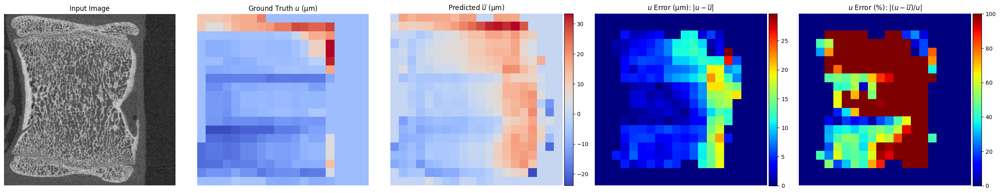

plot  1


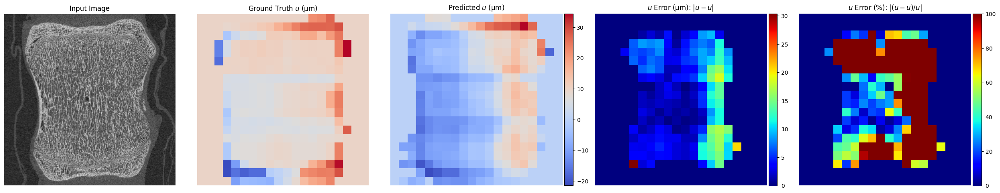

plot  2


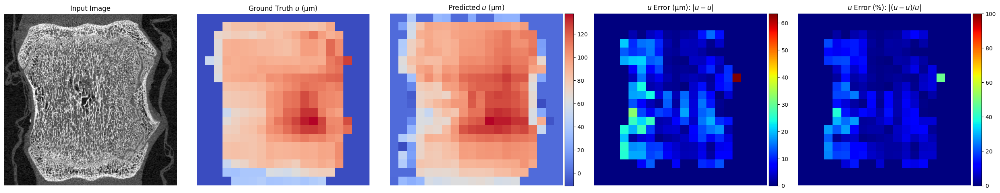

plot  3


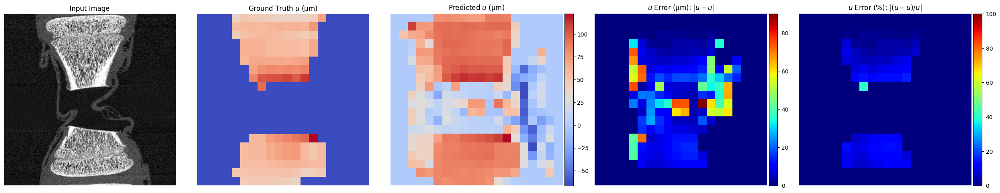

plot  4


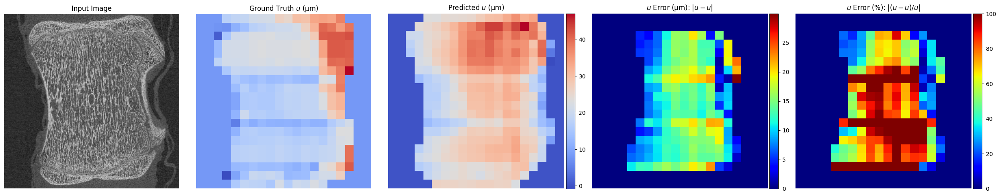

plot  5


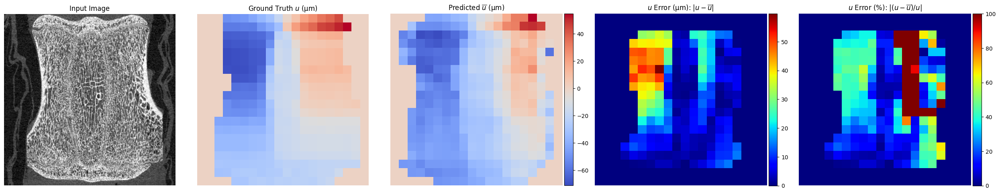

plot  6


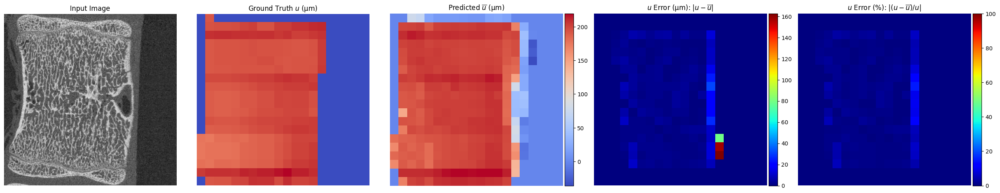

plot  7


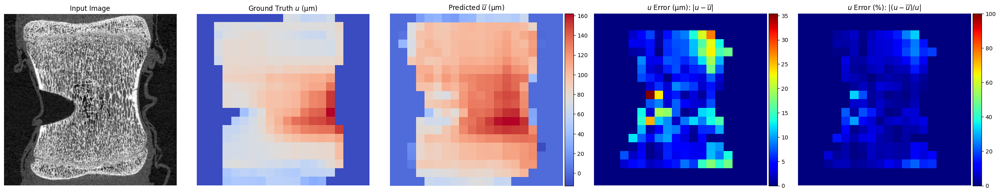

plot  8


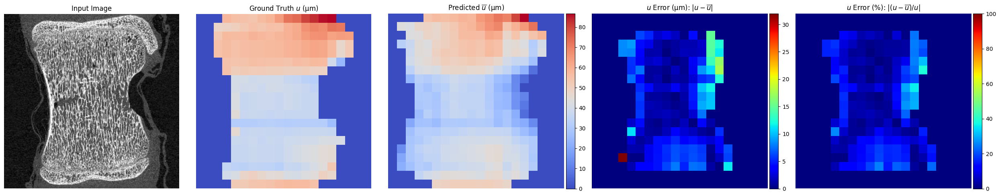

plot  9


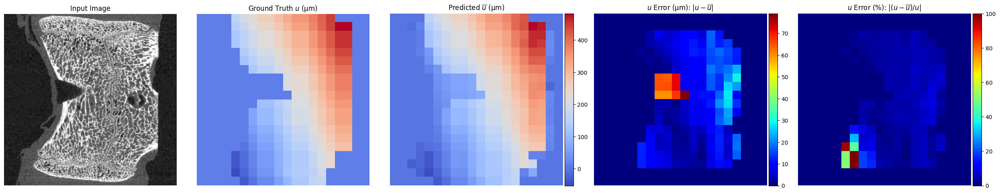

plot  10


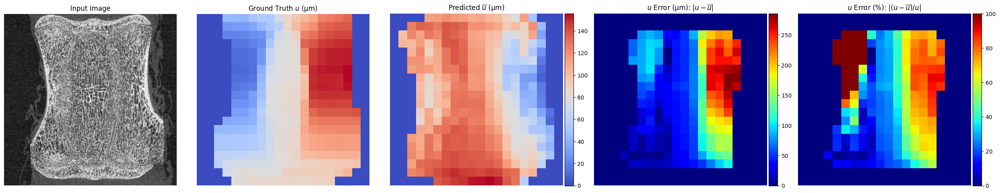

plot  11


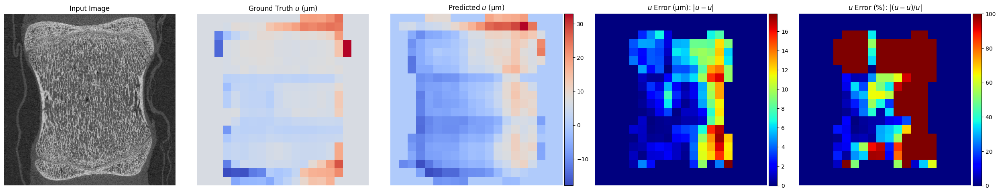

plot  12


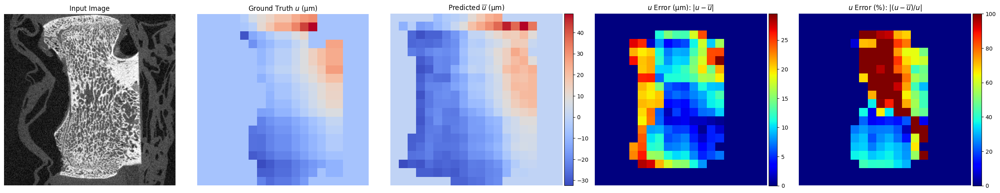

plot  13


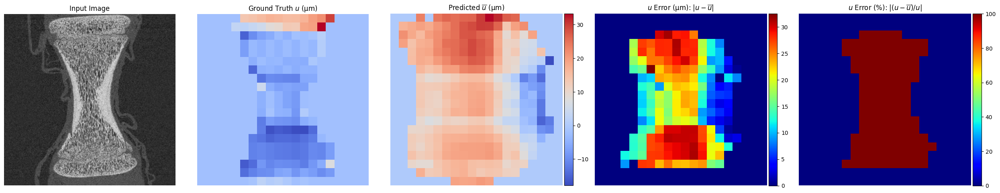

plot  14


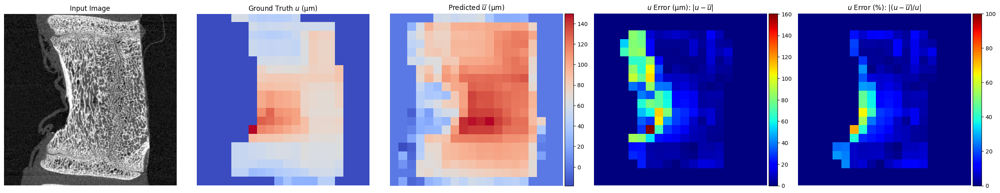

plot  15


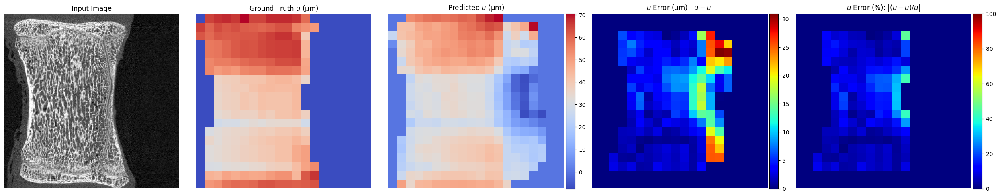

plot  16


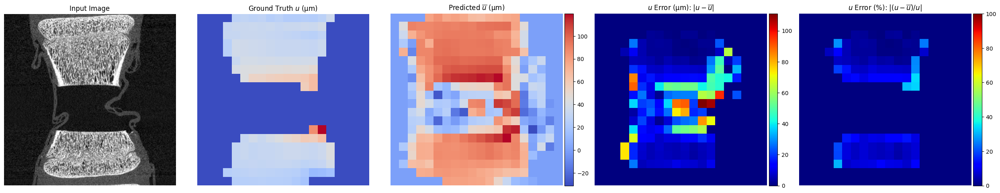

plot  17


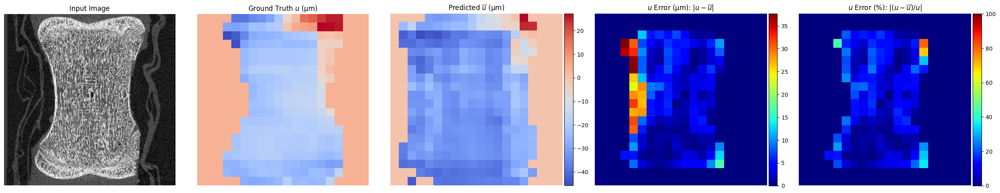

plot  18


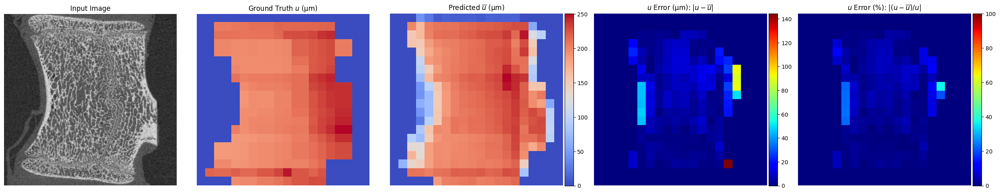

plot  19


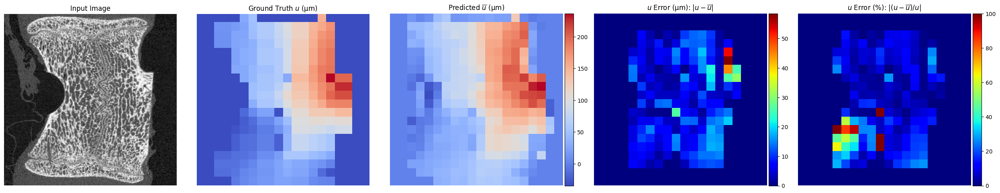

plot  20


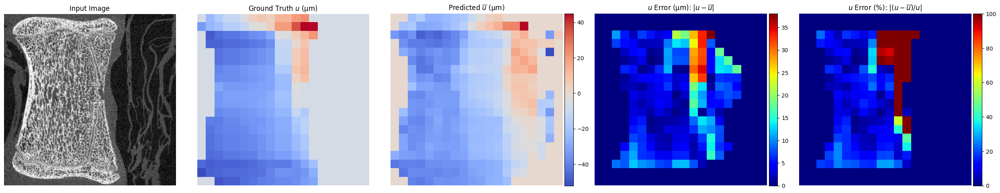

plot  21


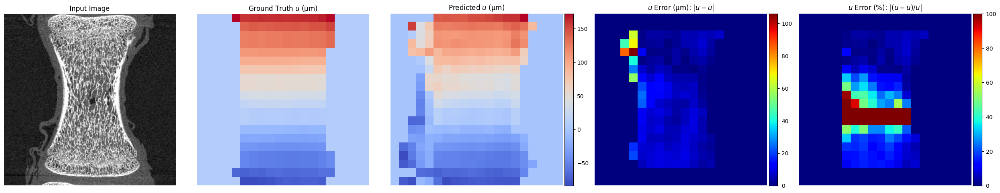

plot  22


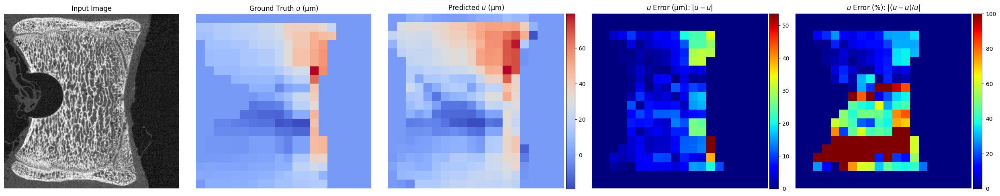

plot  23


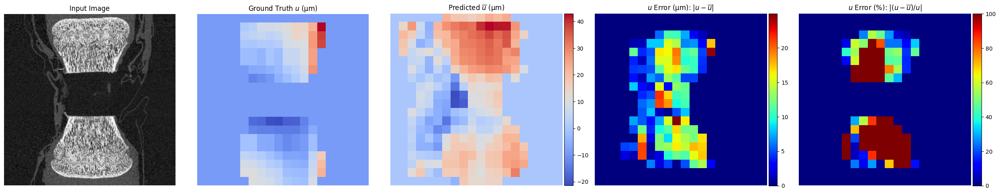

plot  24


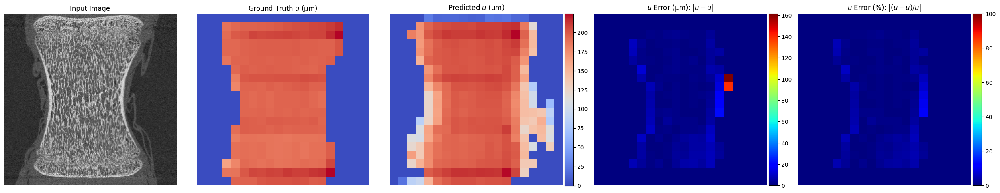

plot  25


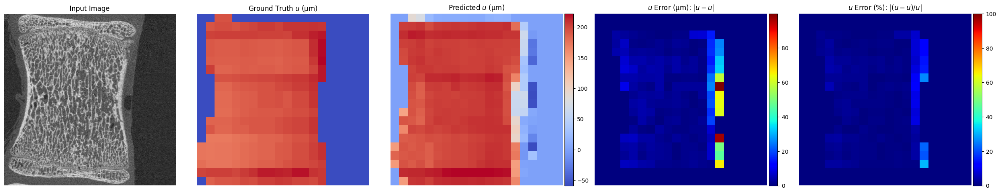

In [ ]:
# View u test displacments
plot_num=target_test_u.shape[0]
vs = 39 #real voxel size um

for i in range(plot_num):  # Loop through each sample
    print("plot ", i)
    plt.figure(figsize=(25, 5))  # Adjust the figure size to accommodate three plots

    predicted_image = np.flipud(predictions[0][i].reshape(output_shape))*vs
    target_image = np.flipud(target_test_u[i])*vs
    min_d=np.array([target_image.min(),predicted_image.min()]).min()
    max_d=np.array([target_image.max(),predicted_image.max()]).max()

    # Load or generate the mask
    msk = binary_erosion(input_data_test2[i].reshape(input_shape2[:2]), iterations = 2)

    # Create a grid of subplots
    gs = gridspec.GridSpec(1, 5, width_ratios=[1, 1, 1.065, 1.065, 1.065])

    # Plot the input image
    ax3 = plt.subplot(gs[0,0])  # Fourth subplot
    input_image = np.flipud(input_data_test1[i].reshape(input_shape1[:2]))
    im3 = ax3.imshow(input_image, cmap='gray', vmin=0, vmax=1)
    ax3.set_title("Input Image")
    ax3.axis('off')

    # Plot the ground truth target value
    ax1 = plt.subplot(gs[0, 1])  # First subplot
    im1 = ax1.imshow(target_image, cmap='coolwarm')
    ax1.set_title("Ground Truth $u$ (μm)")
    ax1.axis('off')

    # Plot the predicted output
    ax2 = plt.subplot(gs[0,2], sharey=ax1)  # Second subplot, sharing y-axis with the first subplot
    im2 = ax2.imshow(predicted_image, cmap='coolwarm')
    ax2.set_title("Predicted $\overline{u}$ (μm)")

    #shared axes
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax2.axis('off')

    # Plot the displacement error
    error = np.abs((target_image*msk-predicted_image*msk))
    error = np.nan_to_num(error, posinf=0, neginf=0)

    ax3 = plt.subplot(gs[0,3])  # First subplot
    im3 = ax3.imshow(error, cmap='jet')
    ax3.set_title("$u$ Error (μm): $|u-\overline{u}|$")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    # Plot the percentage error
    error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
    error = np.nan_to_num(error, posinf=0, neginf=0)

    ax3 = plt.subplot(gs[0,4])  # First subplot
    im3 = ax3.imshow(error, cmap='jet', vmin=0, vmax=100)
    ax3.set_title("$u$ Error (%): $|(u-\overline{u})/u|$")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    plt.tight_layout()  # Ensure plots don't overlap
    plt.show()

plot  0


/tmp/ipykernel_33/1730567438.py:58: RuntimeWarning: divide by zero encountered in divide
  error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
/tmp/ipykernel_33/1730567438.py:58: RuntimeWarning: invalid value encountered in divide
  error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100


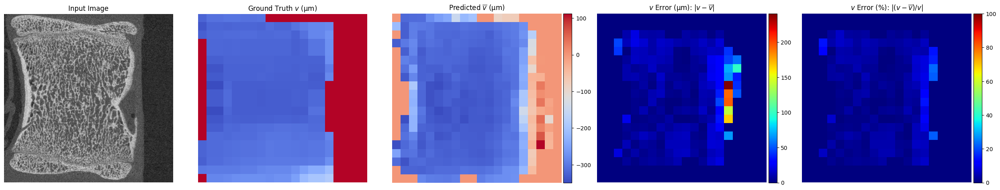

plot  1


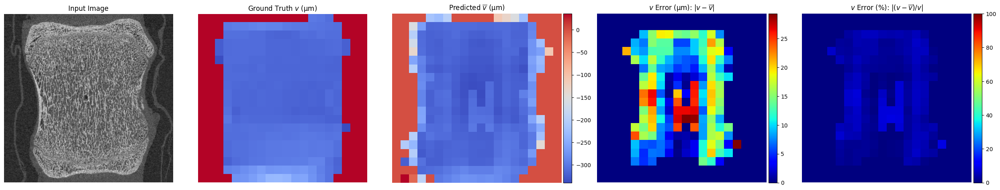

plot  2


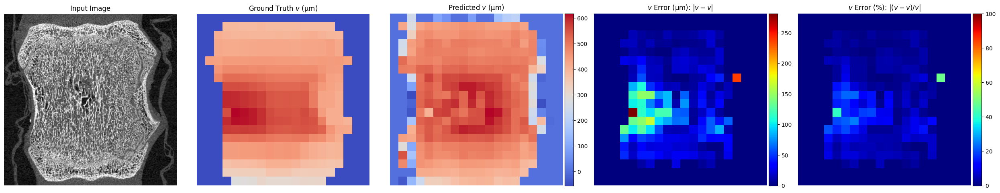

plot  3


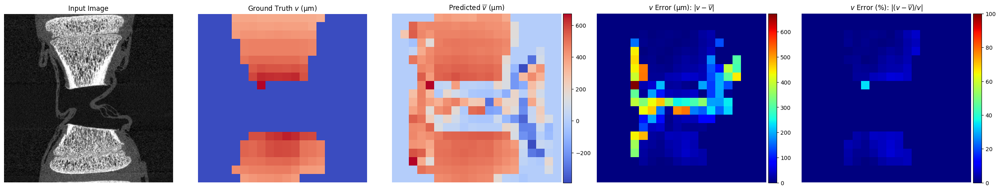

plot  4


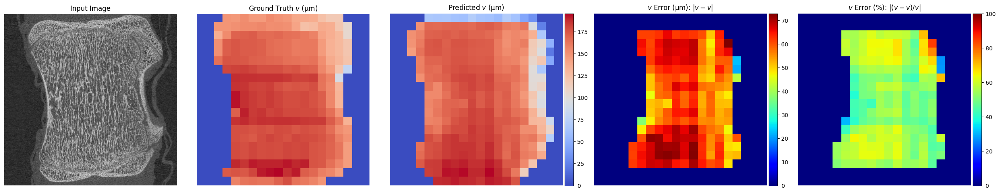

plot  5


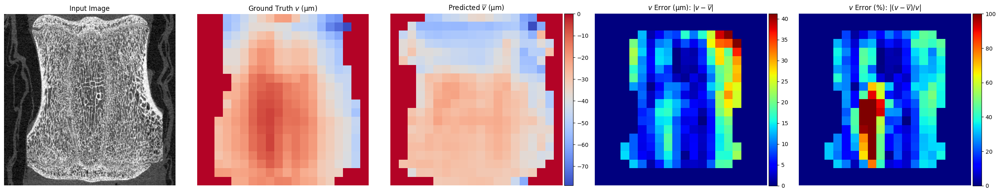

plot  6


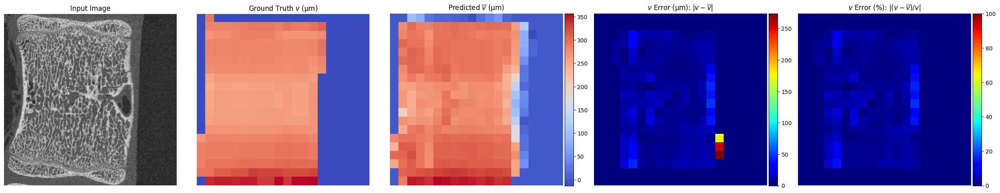

plot  7


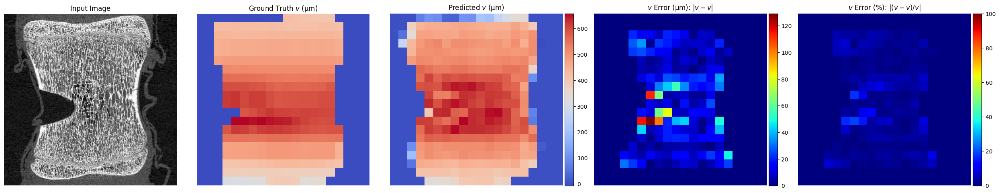

plot  8


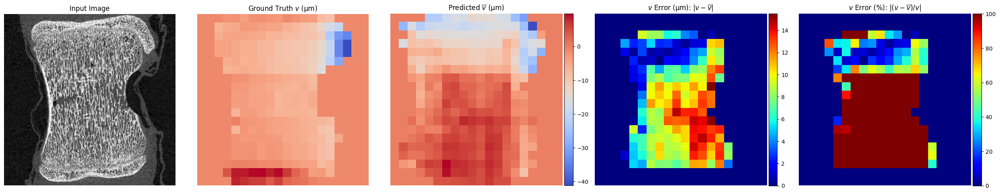

plot  9


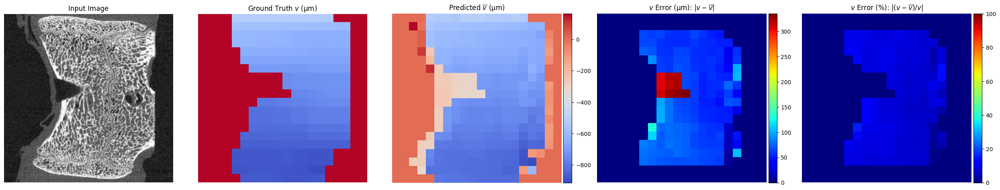

plot  10


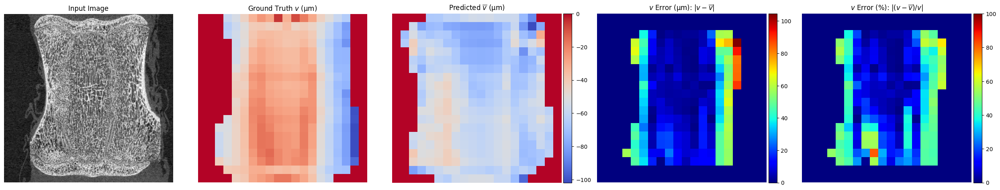

plot  11


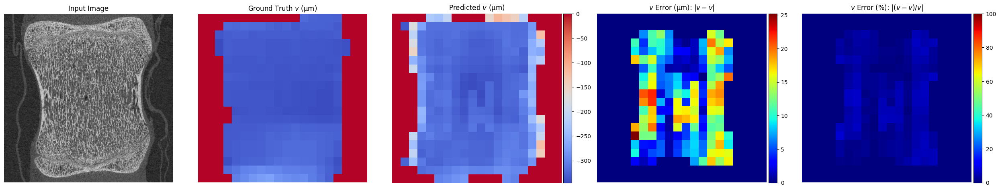

plot  12


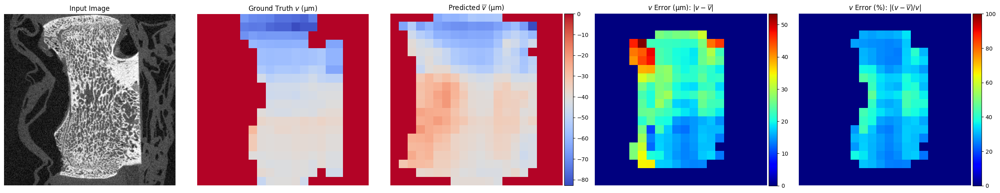

plot  13


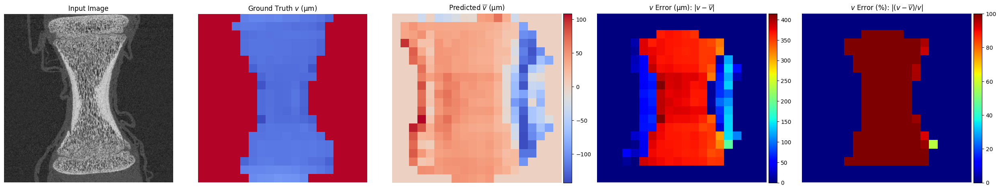

plot  14


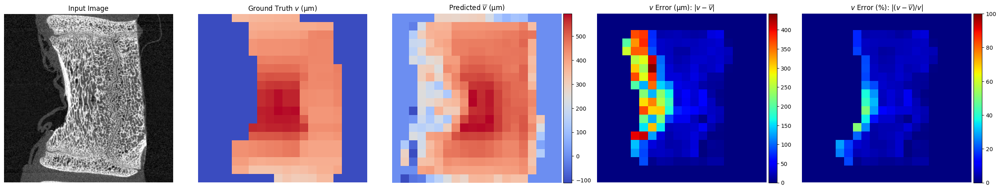

plot  15


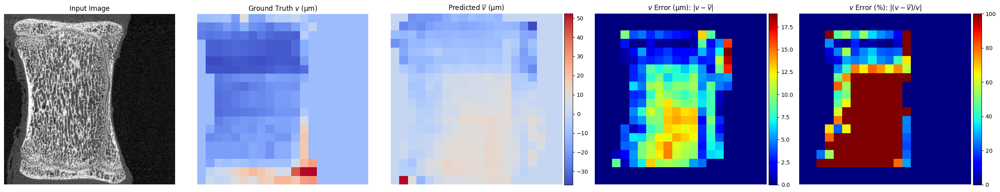

plot  16


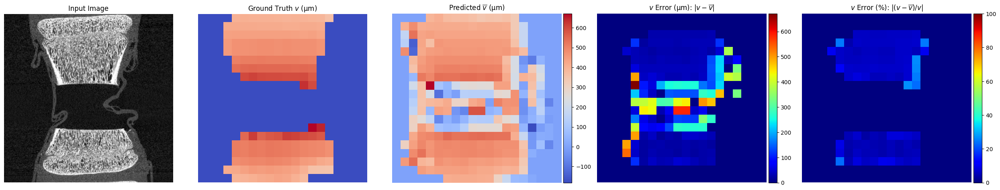

plot  17


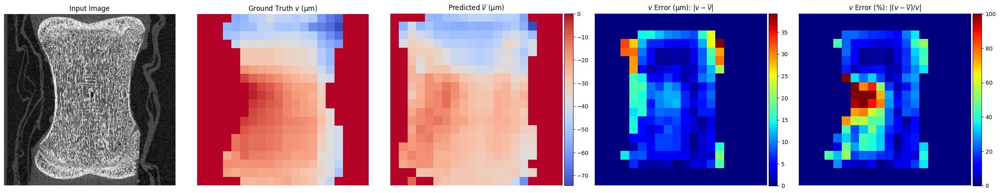

plot  18


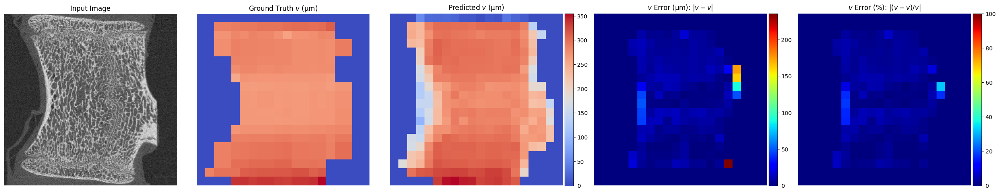

plot  19


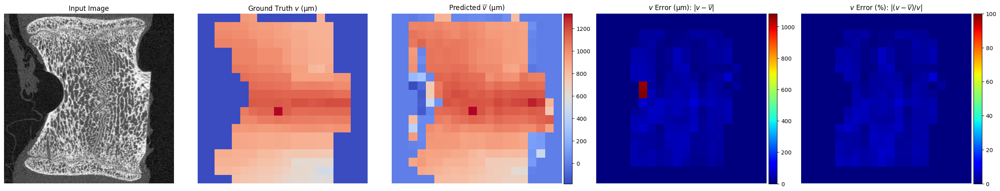

plot  20


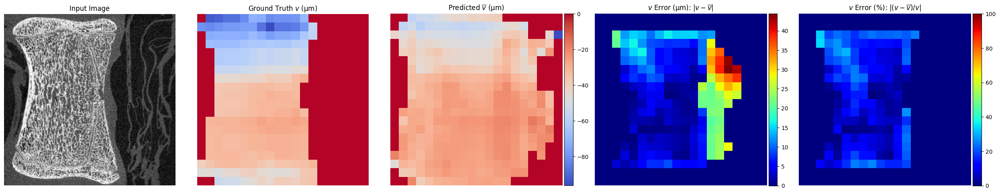

plot  21


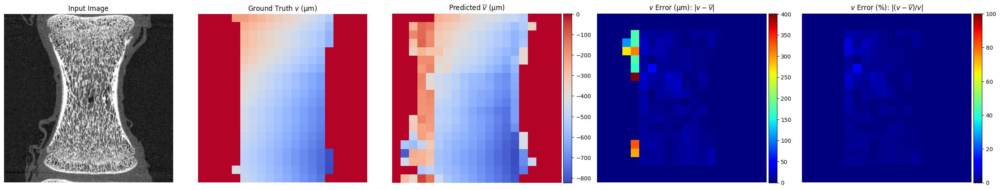

plot  22


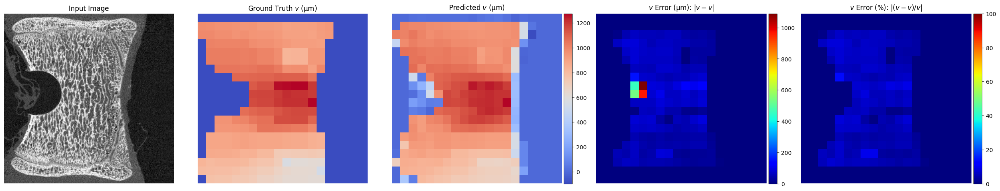

plot  23


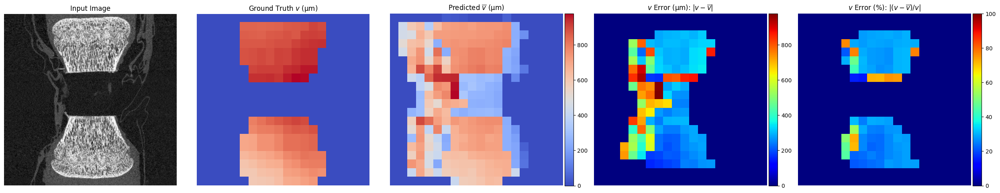

plot  24


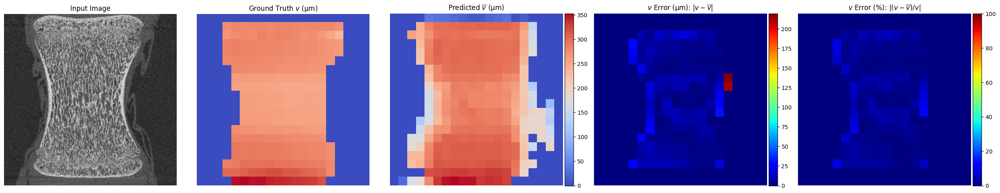

plot  25


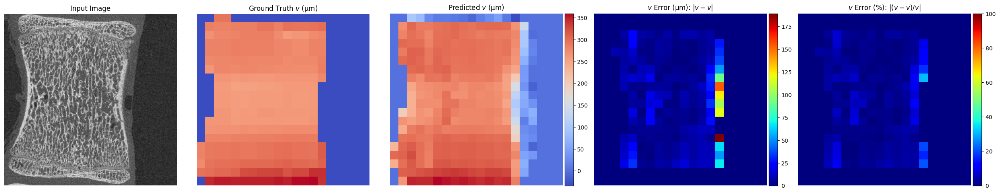

In [ ]:
# View v test displacments
plot_num=target_test_v.shape[0]
vs = 39 #real voxel size um

for i in range(plot_num):  # Loop through each sample
    print("plot ", i)
    plt.figure(figsize=(25, 5))  # Adjust the figure size to accommodate three plots

    predicted_image = np.flipud(predictions[1][i].reshape(output_shape))*vs
    target_image = np.flipud(target_test_v[i])*vs
    min_d=np.array([target_image.min(),predicted_image.min()]).min()
    max_d=np.array([target_image.max(),predicted_image.max()]).max()

    # Load or generate the mask
    msk = binary_erosion(input_data_test2[i].reshape(input_shape2[:2]), iterations = 2)

    # Create a grid of subplots
    gs = gridspec.GridSpec(1, 5, width_ratios=[1, 1, 1.065, 1.065, 1.065])

    # Plot the input image
    ax3 = plt.subplot(gs[0,0])  # Fourth subplot
    input_image = np.flipud(input_data_test1[i].reshape(input_shape1[:2]))
    im3 = ax3.imshow(input_image, cmap='gray', vmin=0, vmax=1)
    ax3.set_title("Input Image")
    ax3.axis('off')

    # Plot the ground truth target value
    ax1 = plt.subplot(gs[0, 1])  # First subplot
    im1 = ax1.imshow(target_image, cmap='coolwarm')
    ax1.set_title("Ground Truth $v$ (μm)")
    ax1.axis('off')

    # Plot the predicted output
    ax2 = plt.subplot(gs[0,2], sharey=ax1)  # Second subplot, sharing y-axis with the first subplot
    im2 = ax2.imshow(predicted_image, cmap='coolwarm')
    ax2.set_title("Predicted $\overline{v}$ (μm)")

    #shared axes
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax2.axis('off')

    # Plot the displacement error
    error = np.abs((target_image*msk-predicted_image*msk))
    ax3 = plt.subplot(gs[0,3])  # First subplot
    im3 = ax3.imshow(error, cmap='jet')
    ax3.set_title("$v$ Error (μm): $|v-\overline{v}|$")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    # Plot the percentage error
    error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
    error = np.nan_to_num(error, posinf=0, neginf=0)
    ax3 = plt.subplot(gs[0,4])  # First subplot
    im3 = ax3.imshow(error, cmap='jet', vmin=0, vmax=100)
    ax3.set_title("$v$ Error (%): $|(v-\overline{v})/v|$")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    plt.tight_layout()  # Ensure plots don't overlap
    plt.show()

plot  0


/tmp/ipykernel_33/695020483.py:57: RuntimeWarning: divide by zero encountered in divide
  error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
/tmp/ipykernel_33/695020483.py:57: RuntimeWarning: invalid value encountered in divide
  error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100


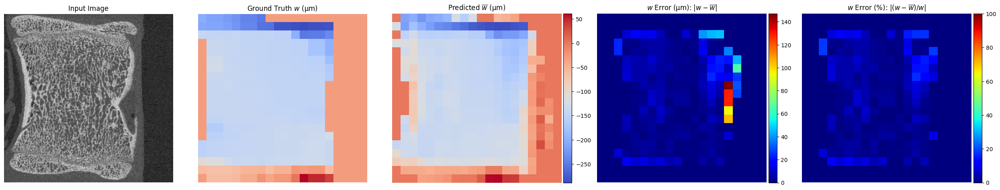

plot  1


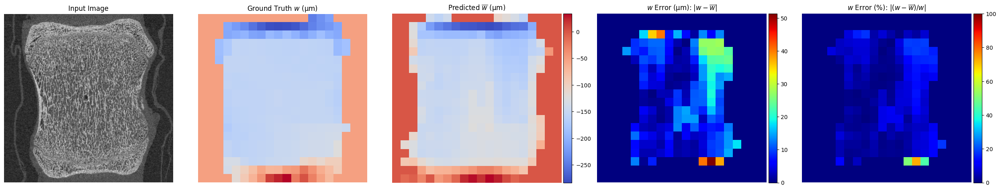

plot  2


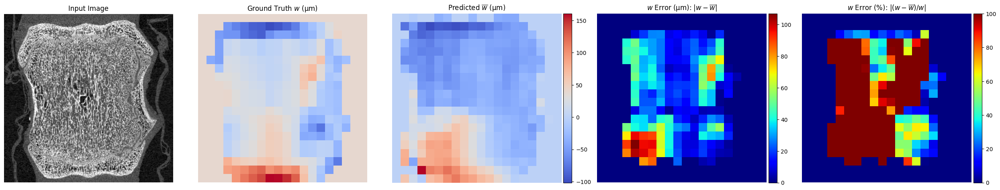

plot  3


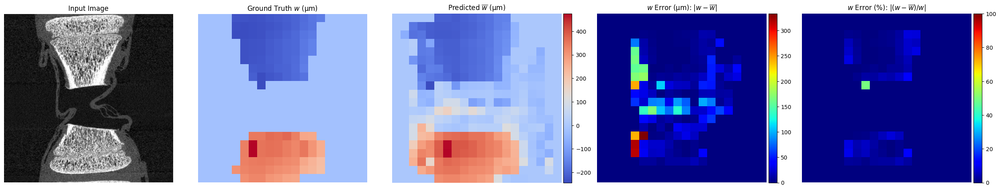

plot  4


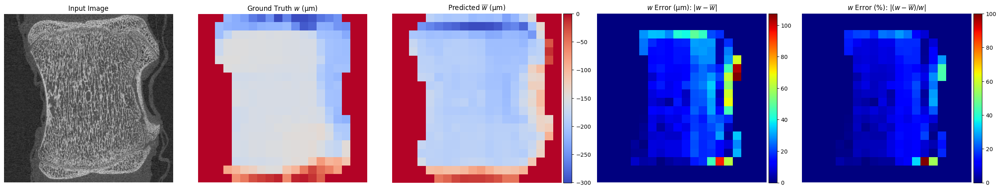

plot  5


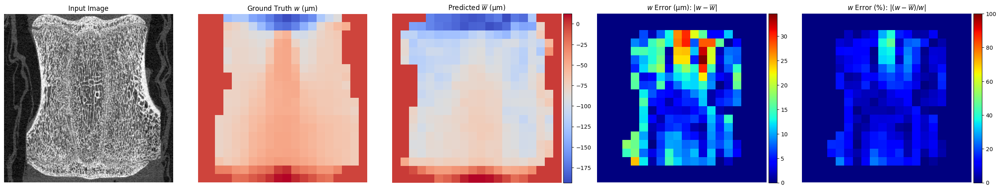

plot  6


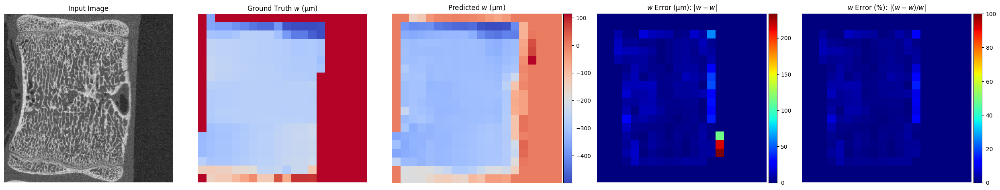

plot  7


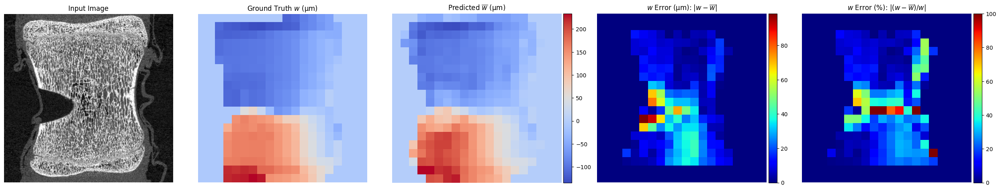

plot  8


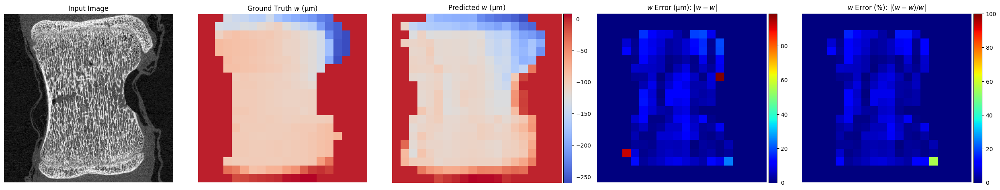

plot  9


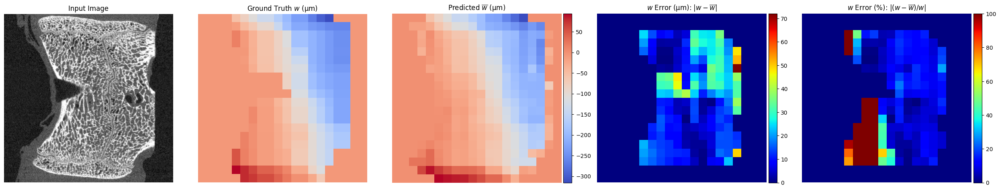

plot  10


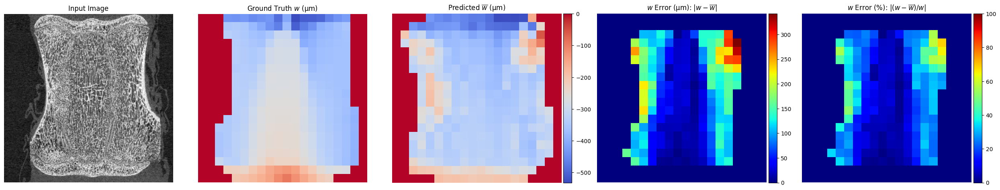

plot  11


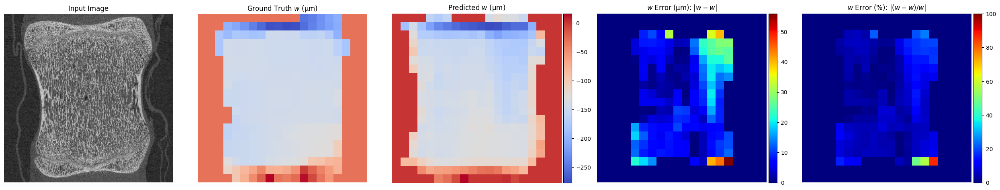

plot  12


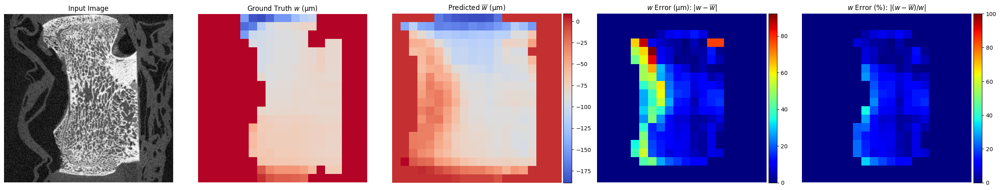

plot  13


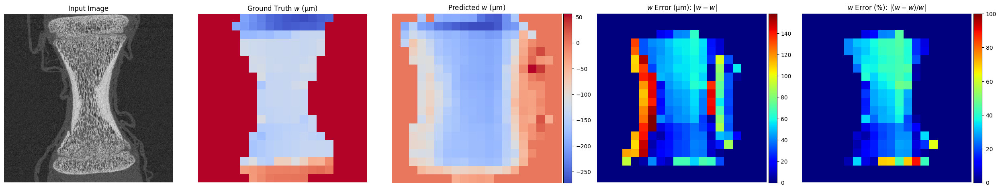

plot  14


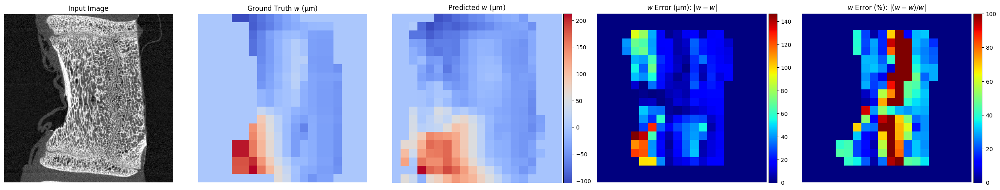

plot  15


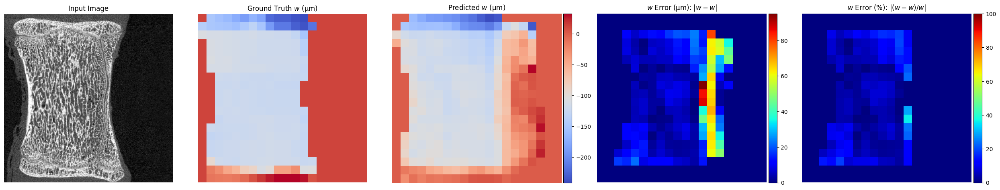

plot  16


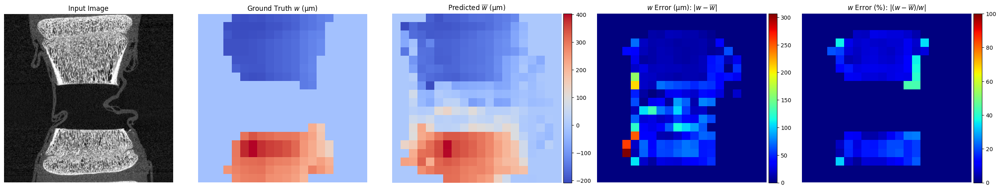

plot  17


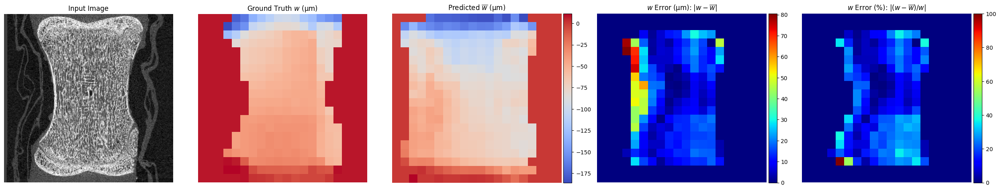

plot  18


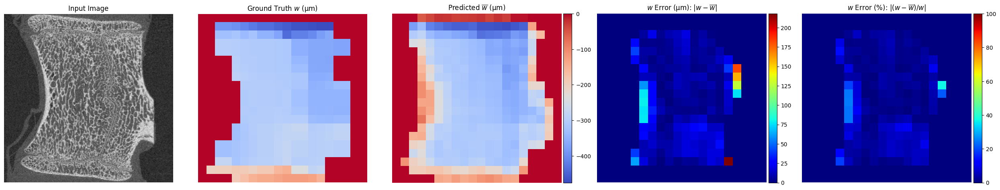

plot  19


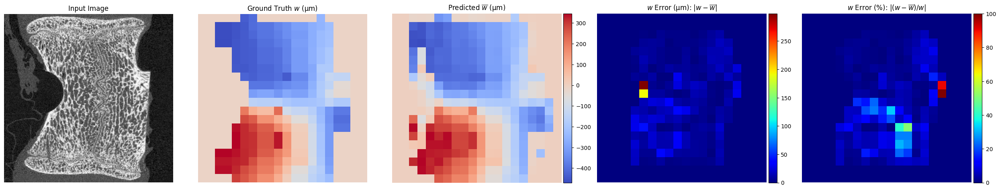

plot  20


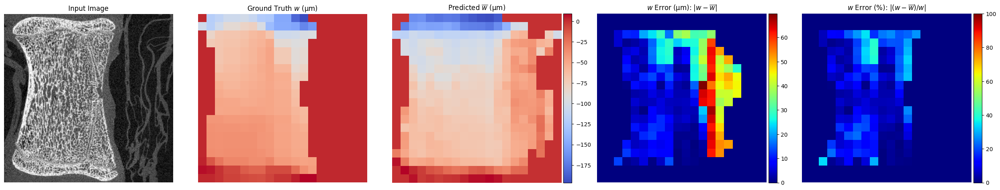

plot  21


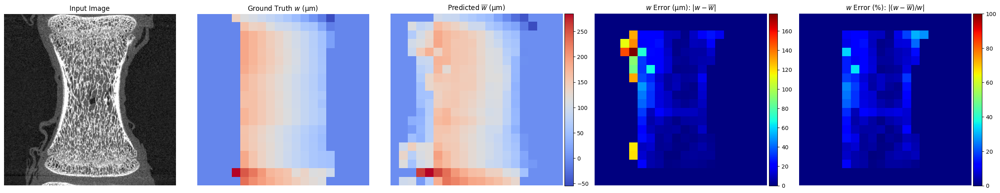

plot  22


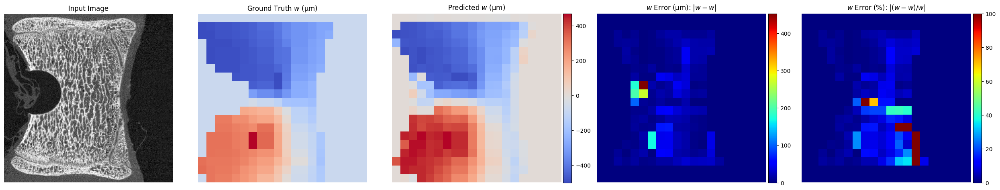

plot  23


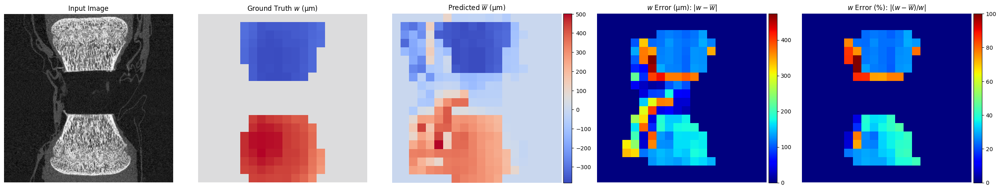

plot  24


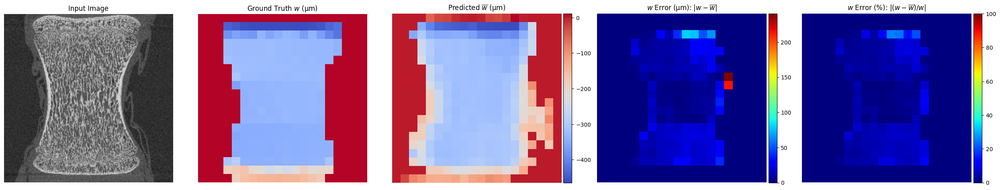

plot  25


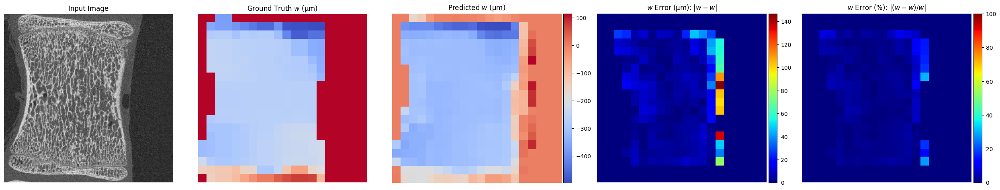

In [ ]:
# View w test displacments
plot_num=target_test_w.shape[0]
vs = 39 #real voxel size um

for i in range(plot_num):  # Loop through each sample
    print("plot ", i)
    plt.figure(figsize=(25, 5))  # Adjust the figure size to accommodate three plots
    predicted_image = np.flipud(predictions[2][i].reshape(output_shape))*vs
    target_image = np.flipud(target_test_w[i])*vs
    min_d=np.array([target_image.min(),predicted_image.min()]).min()
    max_d=np.array([target_image.max(),predicted_image.max()]).max()

    # Load or generate the mask
    msk = binary_erosion(input_data_test2[i].reshape(input_shape2[:2]), iterations = 2)

    # Create a grid of subplots
    gs = gridspec.GridSpec(1, 5, width_ratios=[1, 1, 1.065, 1.065, 1.065])

    # Plot the input image
    ax3 = plt.subplot(gs[0,0])  # Fourth subplot
    input_image = np.flipud(input_data_test1[i].reshape(input_shape1[:2]))
    im3 = ax3.imshow(input_image, cmap='gray', vmin=0, vmax=1)
    ax3.set_title("Input Image")
    ax3.axis('off')

    # Plot the ground truth target value
    ax1 = plt.subplot(gs[0, 1])  # First subplot
    im1 = ax1.imshow(target_image, cmap='coolwarm')
    ax1.set_title("Ground Truth $w$ (μm)")
    ax1.axis('off')

    # Plot the predicted output
    ax2 = plt.subplot(gs[0,2], sharey=ax1)  # Second subplot, sharing y-axis with the first subplot
    im2 = ax2.imshow(predicted_image, cmap='coolwarm')
    ax2.set_title("Predicted $\overline{w}$ (μm)")

    #shared axes
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax2.axis('off')

    # Plot the displacement error
    error = np.abs((target_image*msk-predicted_image*msk))
    ax3 = plt.subplot(gs[0,3])  # First subplot
    im3 = ax3.imshow(error, cmap='jet')
    ax3.set_title("$w$ Error (μm): $|w-\overline{w}|$")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    # Plot the percentage error
    error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
    error = np.nan_to_num(error, posinf=0, neginf=0)
    ax3 = plt.subplot(gs[0,4])  # First subplot
    im3 = ax3.imshow(error, cmap='jet', vmin=0, vmax=100)
    ax3.set_title("$w$ Error (%): $|(w-\overline{w})/w|$")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    plt.tight_layout()  # Ensure plots don't overlap
    plt.show()

plot  3


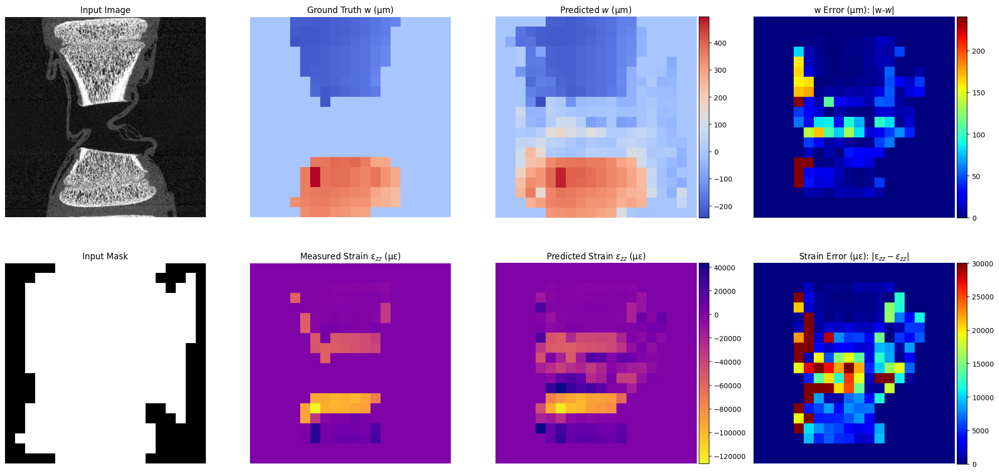

plot  4


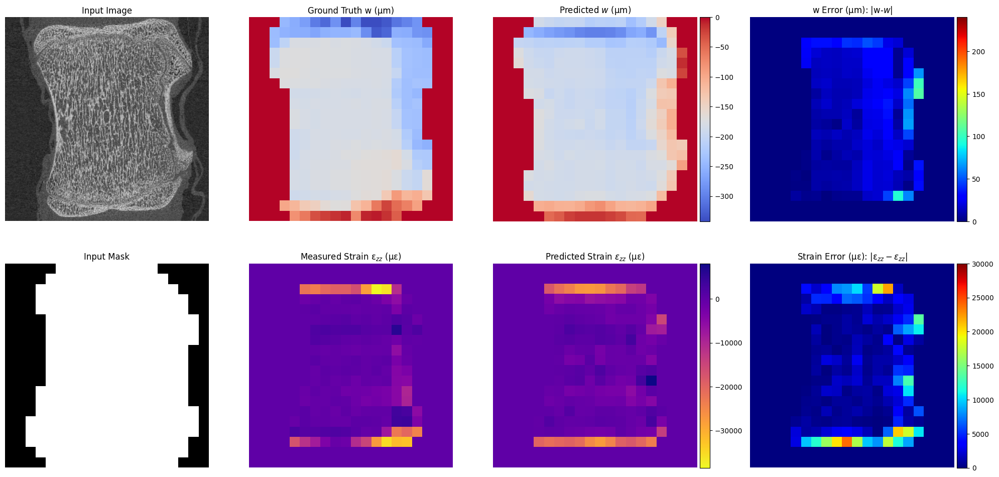

plot  9


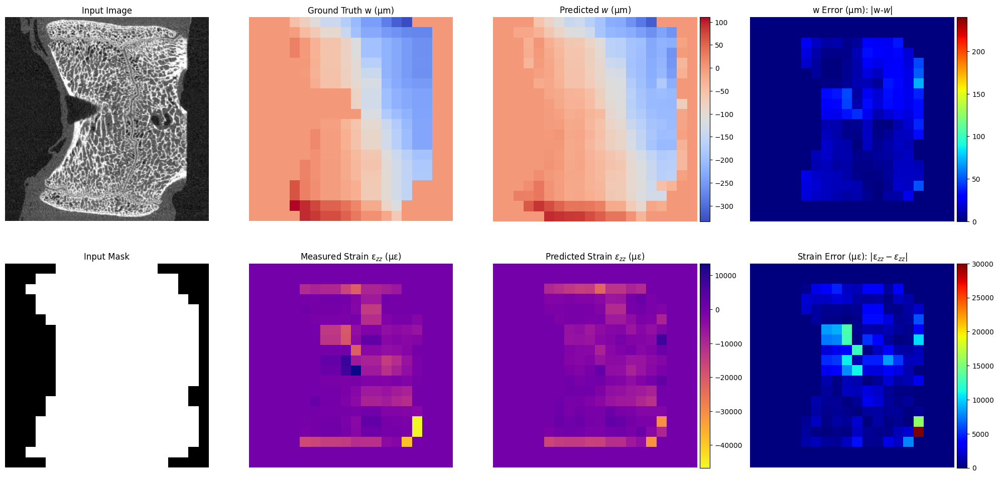

plot  24


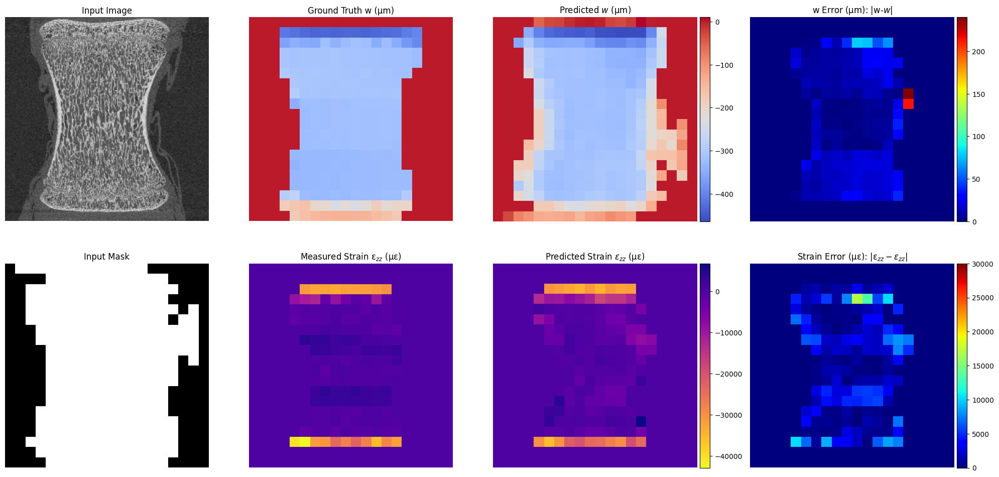

In [ ]:
# Detailed plots with strain 4 cases used in paper
# NOTE: the plot numbers do not currently match due to differnt data importing behaviour in kaggle

plot_num = [3, 4, 9, 24]

vs = 39 #real voxel size um
ns = 50 # Node spacing

def calculate_strain(displacement_w, dx):
    dw_dz = np.gradient(displacement_w, dx,  axis=(0))
    ezz = dw_dz*1e6
    return ezz


# Ontain strain for samples. Includes masking and value capping for better visualisations
for i in plot_num:  # Loop through each sample
    predicted_image = (np.flipud(predictions[2][i].reshape(output_shape)))*vs
    target_image = np.flipud(target_test_w[i])*vs
    msk = binary_erosion(input_data_test2[i].reshape(input_shape2[:2]), iterations = 2)
    ezz_t = np.flipud(calculate_strain(np.flipud(target_image), ns*vs))
    ezz_p = np.flipud(calculate_strain(np.flipud(predicted_image), ns*vs))

    ezz_t_i = np.where(msk, ezz_t.reshape(output_shape), 0.0)
    ezz_p_i = np.where(msk, ezz_p.reshape(output_shape), 0.0)
    if i == 25:
        min_s = -40000
        threshold = -40000
        stress_mask = ezz_t_i < threshold
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0
    min_err_bar = 0
    max_err_bar = np.max(np.abs(target_image-predicted_image)*msk)
    min_strerr_bar = 0
    max_strerr_bar = np.max(np.abs(ezz_t_i-ezz_p_i))
    max_strerr_bar = 30000


for i in plot_num:  # Loop through each sample
    print("plot ", i)
    plt.figure(figsize=(20, 10))  # Adjust the figure size to accommodate three plots

    predicted_image = (np.flipud(predictions[2][i].reshape(output_shape)))*vs
    target_image = np.flipud(target_test_w[i])*vs
    min_d=np.array([target_image.min(),predicted_image.min()]).min()
    max_d=np.array([target_image.max(),predicted_image.max()]).max()

    # Load or generate the mask
    msk = binary_erosion(input_data_test2[i].reshape(input_shape2[:2]), iterations = 2)

    ezz_t = np.flipud(calculate_strain(np.flipud(target_image), ns*vs))
    ezz_p = np.flipud(calculate_strain(np.flipud(predicted_image), ns*vs))
    # Apply the mask to the strain field
    ezz_t_i = np.where(msk, ezz_t.reshape(output_shape), 0.0)
    ezz_p_i = np.where(msk, ezz_p.reshape(output_shape), 0.0)

    min_s=np.array([ezz_t_i.min(),ezz_p_i.min()]).min()
    max_s=np.array([ezz_t_i.max(),ezz_p_i.max()]).max()

    # Masking and value capping for clearer visualisations
    if i == 4:
        threshold = -40000
        stress_mask = ezz_t_i < threshold
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0
        min_s = -30000


    if i == 24:
        threshold = -60000
        stress_mask = ezz_t_i < threshold
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0


    if i == 9:
        threshold1 = -129000
        threshold2 = -129500
        stress_mask = (ezz_t_i <= threshold1) & (ezz_t_i >= threshold2)
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0

    min_s=np.array([ezz_t_i.min(),ezz_p_i.min()]).min()
    max_s=np.array([ezz_t_i.max(),ezz_p_i.max()]).max()

    # Create a grid of subplots
    gs = gridspec.GridSpec(2, 4, width_ratios=[1, 1, 1.065, 1.065])

    # Plot the input image
    ax3 = plt.subplot(gs[0,0])  # Fourth subplot
    input_image = np.flipud(input_data_test1[i].reshape(input_shape1[:2]))
    im3 = ax3.imshow(input_image, cmap='gray', vmin=0, vmax=1)
    ax3.set_title("Input Image")
    ax3.axis('off')

    # Plot the ground truth target value
    ax1 = plt.subplot(gs[0, 1])  # First subplot
    im1 = ax1.imshow(target_image, cmap='coolwarm', vmin=min_d, vmax=max_d)
    ax1.set_title("Ground Truth w (μm)")
    ax1.axis('off')

    # Plot the predicted output
    ax2 = plt.subplot(gs[0,2], sharey=ax1)  # Second subplot, sharing y-axis with the first subplot
    im2 = ax2.imshow(predicted_image, cmap='coolwarm', vmin=min_d, vmax=max_d)
    ax2.set_title("Predicted $w$ (μm)")

    #shared axes
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax2.axis('off')

    error = np.abs(target_image-predicted_image)*msk

    ax3 = plt.subplot(gs[0,3])  # First subplot
    #im3 = ax3.imshow(error, cmap='jet')
    im3 = ax3.imshow(error, cmap='jet', vmin=min_err_bar, vmax=max_err_bar)
    ax3.set_title("w Error (μm): |w-$w$|")
    ax3.axis('off')
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    # Plot the input image
    ax3 = plt.subplot(gs[1,0])  # Fourth subplot
    im3 = ax3.imshow(input_data_test2[i].reshape(input_shape2[:2]), cmap='gray', vmin=0, vmax=1)
    ax3.set_title("Input Mask")
    ax3.axis('off')

    # Plot the ground truth target value
    ax1 = plt.subplot(gs[1,1])  # First subplot
    im1 = ax1.imshow(ezz_t_i, cmap='plasma_r', vmin=min_s, vmax=max_s)
    ax1.set_title("Measured Strain ε$_{zz}$ (με)")
    ax1.axis('off')

    # Plot the predicted output
    ax2 = plt.subplot(gs[1,2], sharey=ax1)  # Second subplot, sharing y-axis with the first subplot
    im2 = ax2.imshow(ezz_p_i, cmap='plasma_r', vmin=min_s, vmax=max_s)
    ax2.set_title("Predicted Strain $ε_{zz}$ (με)")
    ax2.axis('off')

    #shared axes
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax2.axis('off')

    # Plot the displacement error
    ax3 = plt.subplot(gs[1,3])  # First subplot
    im3 = ax3.imshow(np.abs(ezz_t_i-ezz_p_i), cmap='jet', vmin=0, vmax=max_strerr_bar)
    ax3.set_title("Strain Error (με): |ε$_{zz}-ε_{zz}$|")

    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
    plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
    cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
    ax3.axis('off')

    plt.tight_layout()  # Ensure plots don't overlap
    plt.show()


/tmp/ipykernel_33/4113220668.py:83: RuntimeWarning: divide by zero encountered in divide
  error = np.abs((ezz_t_i - ezz_p_i) / ezz_t_i) * 100
/tmp/ipykernel_33/4113220668.py:83: RuntimeWarning: invalid value encountered in divide
  error = np.abs((ezz_t_i - ezz_p_i) / ezz_t_i) * 100


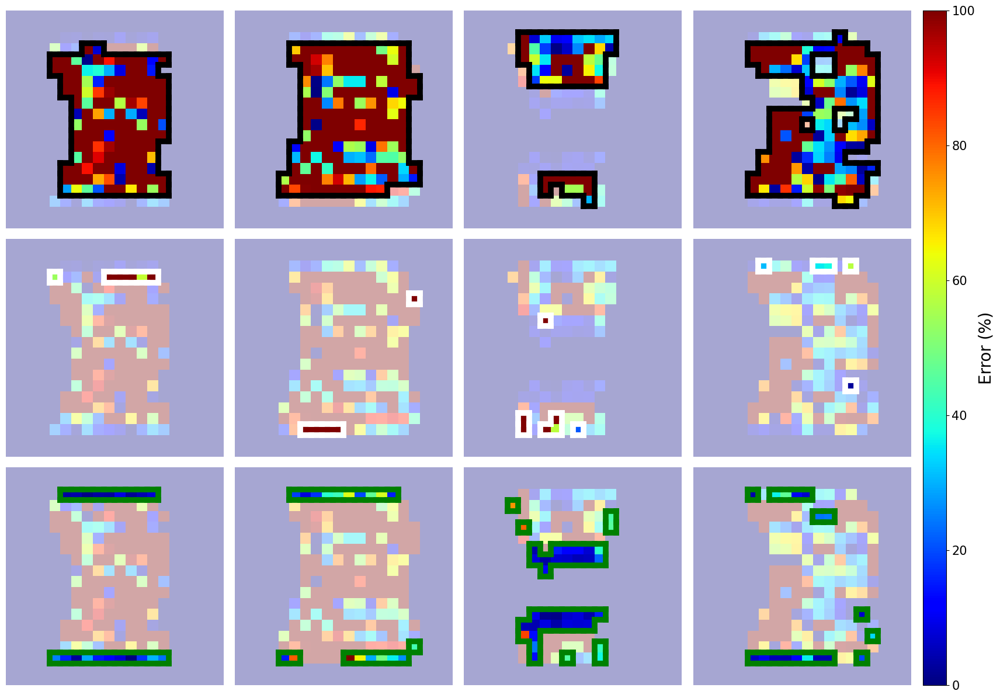

In [ ]:
def strainOutput(predictions, target_test_w, i):
    predicted_image = (np.flipud(predictions.reshape(output_shape)))*vs
    target_image = np.flipud(target_test_w)*vs
    min_d=np.array([target_image.min(),predicted_image.min()]).min()
    max_d=np.array([target_image.max(),predicted_image.max()]).max()

    # Load or generate the mask
    msk = binary_erosion(input_data_test2[i].reshape(input_shape2[:2]), iterations = 2)

    ezz_t = np.flipud(calculate_strain(np.flipud(target_image), ns*vs))
    ezz_p = np.flipud(calculate_strain(np.flipud(predicted_image), ns*vs))
    ezz_t_i = np.where(msk, ezz_t.reshape(output_shape), 0.0)
    ezz_p_i = np.where(msk, ezz_p.reshape(output_shape), 0.0)

    min_s=np.array([ezz_t_i.min(),ezz_p_i.min()]).min()
    max_s=np.array([ezz_t_i.max(),ezz_p_i.max()]).max()

    # Removing some outliers from edges of plot
    if i == 4:
        threshold = -40000
        stress_mask = ezz_t_i < threshold
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0
        min_s = -30000

    if i == 24:
        threshold = -60000
        stress_mask = ezz_t_i < threshold
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0


    if i == 9:
        threshold1 = -129000
        threshold2 = -129500
        stress_mask = (ezz_t_i <= threshold1) & (ezz_t_i >= threshold2)
        ezz_t_i[stress_mask] = 0
        ezz_p_i[stress_mask] = 0

    min_s=np.array([ezz_t_i.min(),ezz_p_i.min()]).min()
    max_s=np.array([ezz_t_i.max(),ezz_p_i.max()]).max()
    return ezz_t_i, ezz_p_i

def highlight_edges(ax, error, ezz_t_i, ezz_p_i, color, highlight):
    if highlight == 1:
        highlight_mask = (np.abs(ezz_p_i) < 10000) & (np.abs(ezz_t_i) < 10000) & (error > 0)
    elif highlight == 2:
        highlight_mask = (np.abs(ezz_p_i) > 10000) & (np.abs(ezz_t_i) < 10000) & (error > 0)
    elif highlight == 3:
        highlight_mask = (np.abs(ezz_p_i) > 10000) & (np.abs(ezz_t_i) > 10000) & (error > 0)

    # Apply transparency to the error plot outside of the highlight box
    im = ax.imshow(np.ma.masked_where(highlight_mask, error), cmap='jet', vmin=0, vmax=100, alpha=0.35)
    im = ax.imshow(np.ma.masked_where(~highlight_mask, error), cmap='jet', vmin=0, vmax=100, alpha=1.0)

    for i in range(error.shape[0]):
        for j in range(error.shape[1]):
            if highlight_mask[i, j]:
                if i == 0 or not highlight_mask[i - 1, j]:
                    ax.plot([j - 0.5, j + 0.5], [i - 0.5, i - 0.5], color=color, linewidth=7)  # Upper edge
                if i == error.shape[0] - 1 or not highlight_mask[i + 1, j]:
                    ax.plot([j - 0.5, j + 0.5], [i + 0.5, i + 0.5], color=color, linewidth=7)  # Lower edge
                if j == 0 or not highlight_mask[i, j - 1]:
                    ax.plot([j - 0.5, j - 0.5], [i - 0.5, i + 0.5], color=color, linewidth=7)  # Left edge
                if j == error.shape[1] - 1 or not highlight_mask[i, j + 1]:
                    ax.plot([j + 0.5, j + 0.5], [i - 0.5, i + 0.5], color=color, linewidth=7)  # Right edge

    return im  # Return the imshow object

# Create a figure and axis
fig = plt.figure(figsize=(20, 15))

# Create a grid of subplots
gs_main = gridspec.GridSpec(3, 4, width_ratios=[1, 1, 1, 1], hspace=0.05, wspace=0.05)

# List to store imshow objects
im_list = []

# Iterate over plots
plots = [24, 4, 3, 9]
for i, plot in enumerate(plots):
    ezz_t_i, ezz_p_i = strainOutput(predictions[2][plot], target_test_w[plot], plot)

    error = np.abs((ezz_t_i - ezz_p_i) / ezz_t_i) * 100
    error = np.nan_to_num(error, posinf=0, neginf=0)

    ax = fig.add_subplot(gs_main[0, i])  # First subplot
    im_list.append(highlight_edges(ax, error, ezz_t_i, ezz_p_i, 'black', 1))
    ax.axis('off')

    ax = fig.add_subplot(gs_main[1, i])  # Second subplot
    im_list.append(highlight_edges(ax, error, ezz_t_i, ezz_p_i, 'white', 2))
    ax.axis('off')

    ax = fig.add_subplot(gs_main[2, i])  # Third subplot
    im_list.append(highlight_edges(ax, error, ezz_t_i, ezz_p_i, 'green', 3))
    ax.axis('off')

# Create a grid spec for colorbar
gs_colorbar = gridspec.GridSpec(1, 1)
gs_colorbar.update(left=0.91, right=0.93, bottom=0.11, top=0.88)

# Add colorbar
cbar_ax = fig.add_subplot(gs_colorbar[0])
cbar = plt.colorbar(im_list[0], cax=cbar_ax)  # Use the first imshow object for color range
cbar.ax.tick_params(labelsize=15)
cbar.set_label('Error (%)', fontsize=20)
plt.show()


<h1>Statistics</h1>

In [ ]:
# Distribution of u predictions

mean = np.mean(target_test_u)*vs
std_dev = np.std(target_test_u)*vs
min_value = np.min(target_test_u)*vs
max_value = np.max(target_test_u)*vs

# Print the summary statistics
print("Mean Measued U:", mean)
print("Standard Deviation Measued U:", std_dev)
print("Min Value Measued U:", min_value)
print("Max Value Measued U:", max_value)

mean = np.mean(predictions[0])*vs
std_dev = np.std(predictions[0])*vs
min_value = np.min(predictions[0])*vs
max_value = np.max(predictions[0])*vs

# Print the summary statistics
print("Mean Predicted U:", mean)
print("Standard Deviation Predicted U:", std_dev)
print("Min Value Predicted U:", min_value)
print("Max Value Predicted U:", max_value)

Mean Measued U: 44.15785503387451
Standard Deviation Measued U: 81.39684534072876
Min Value Measued U: -112.3050434589386
Max Value Measued U: 493.70990467071533
Mean Predicted U: 43.57145619392395
Standard Deviation Predicted U: 74.15431988239288
Min Value Predicted U: -83.80434894561768
Max Value Predicted U: 482.54347229003906


In [ ]:
# Distribution of v predictions

mean = np.mean(target_test_v)*vs
std_dev = np.std(target_test_v)*vs
min_value = np.min(target_test_v)*vs
max_value = np.max(target_test_v)*vs

# Print the summary statistics
print("Mean Measued V:", mean)
print("Standard Deviation Measued V:", std_dev)
print("Min Value Measued V:", min_value)
print("Max Value Measued V:", max_value)

mean = np.mean(predictions[1])*vs
std_dev = np.std(predictions[1])*vs
min_value = np.min(predictions[1])*vs
max_value = np.max(predictions[1])*vs

# Print the summary statistics
print("Mean Predicted V:", mean)
print("Standard Deviation Predicted V:", std_dev)
print("Min Value Predicted V:", min_value)
print("Max Value Predicted V:", max_value)

Mean Measued V: 74.71498560905457
Standard Deviation Measued V: 352.0445365905762
Min Value Measued V: -920.9851398468018
Max Value Measued V: 1388.6951065063477
Mean Predicted V: 88.24364805221558
Standard Deviation Predicted V: 332.19361782073975
Min Value Predicted V: -912.761999130249
Max Value Predicted V: 1332.992042541504


In [ ]:
# Distribution of w predictions

mean = np.mean(target_test_w)*vs
std_dev = np.std(target_test_w)*vs
min_value = np.min(target_test_w)*vs
max_value = np.max(target_test_w)*vs

# Print the summary statistics
print("Mean Measued W:", mean)
print("Standard Deviation Measued W:", std_dev)
print("Min Value Measued W:", min_value)
print("Max Value Measued W:", max_value)

mean = np.mean(predictions[2])*vs
std_dev = np.std(predictions[2])*vs
min_value = np.min(predictions[2])*vs
max_value = np.max(predictions[2])*vs

# Print the summary statistics
print("Mean Predicted W:", mean)
print("Standard Deviation Predicted W:", std_dev)
print("Min Value Predicted W:", min_value)
print("Max Value Predicted W:", max_value)

Mean Measued W: -78.7435405254364
Standard Deviation Measued W: 158.58556652069092
Min Value Measued W: -727.5285129547119
Max Value Measued W: 637.9599838256836
Mean Predicted W: -79.24115896224976
Standard Deviation Predicted W: 144.75193762779236
Min Value Predicted W: -531.5705251693726
Max Value Predicted W: 501.5592155456543


/tmp/ipykernel_33/2828661291.py:135: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in legend.legendHandles:


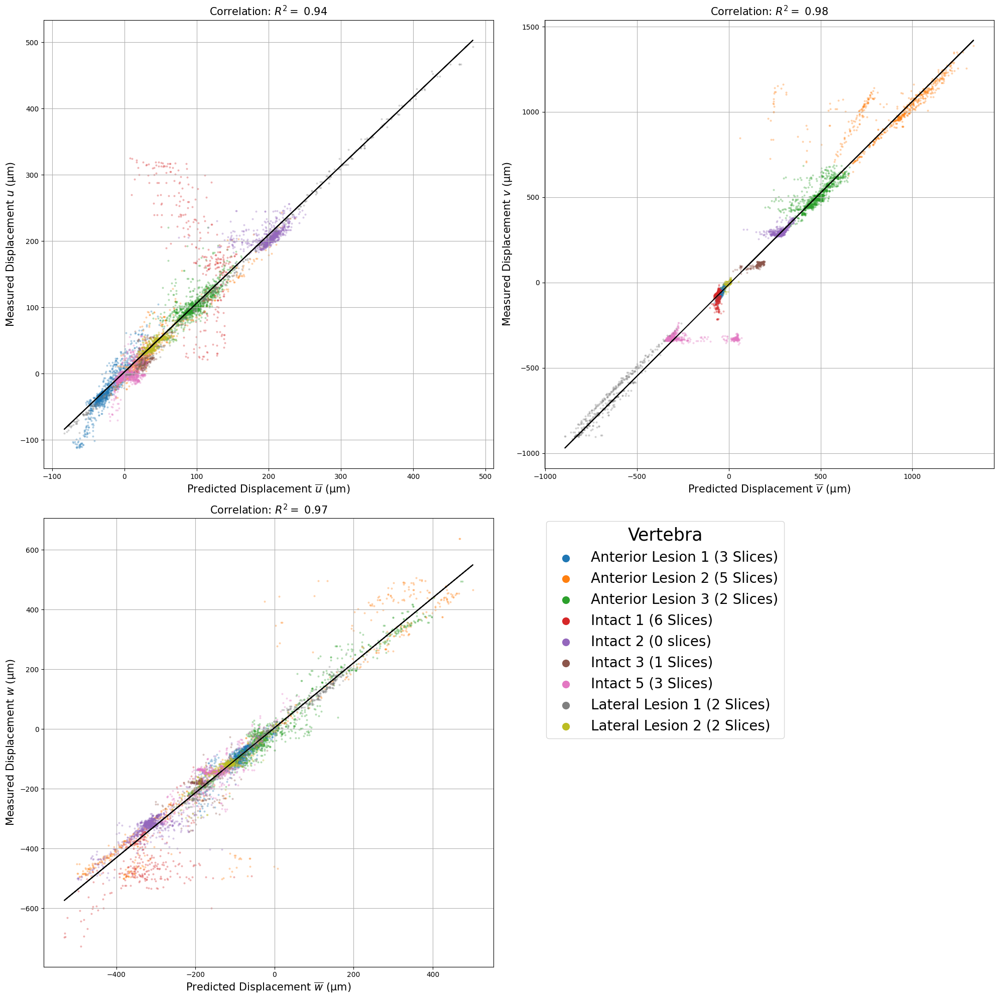

In [ ]:
# Create a coloured correlation analysis between predicted and observed values

from matplotlib import cm
from scipy.stats import pearsonr

# Reimport scan data to get mappings to label each image with the vertebra
# Define directory paths
trainPath = '/data/Input/Scan'

#Define function to import images
def import_images_label(folder_path, name):
    image_data_list = []
    file_path = os.path.join(folder_path, name)
    img = tiff.imread(file_path)
    img[np.isnan(img)] = 0
    # Extract the identifier from the file name
    identifier = name.split("_")[0]  # Assuming the identifier is before the first underscore
    image_data_list.append((img, identifier))
    return image_data_list

# Get the list of files in testPathU (this was chosen generically as files in all directories have the same name)
test_u_files = set([f for f in os.listdir(testPathU) if os.path.isfile(os.path.join(testPathU, f))])

bone_data = [[], [], [], [], []]
for file in os.listdir(trainPath):
    if file in test_u_files:
        bone_data[0].extend(import_images_label(trainPath, file))

ident_only = [data[1] for data in bone_data[0]]

ident_NT, ident_test = train_test_split(ident_only, test_size=0.1, random_state=RS, shuffle=True)
ident_test=np.array(ident_test)

# Define the mappings
# Slice numbers obtained using: np.unique(ident_test, return_counts=True)
mapping = {
    'S1': "Intact 1 (6 Slices)",
    'S2': "Anterior Lesion 1 (3 Slices)",
    'S3': "Intact 2 (0 slices)",
    'S4': "Lateral Lesion 1 (2 Slices)",
    'S5': "Intact 3 (1 Slices)",
    'S6': "Lateral Lesion 2 (2 Slices)",
    'S7': "Intact 4 (2 Slices)",
    'S8': "Anterior Lesion 2 (5 Slices)",
    'S9': "Intact 5 (3 Slices)",
    'S10': "Anterior Lesion 3 (2 Slices)"
}

# Create a new variable with the updated strings based on the mappings
new_ident_test = np.vectorize(mapping.get)(ident_test)

ident_test_3d = new_ident_test.reshape((26, 1, 1))  # Reshape to 26x1x1

# Now, use broadcasting to repeat the values along the other dimensions
ident_test_3d = np.broadcast_to(ident_test_3d, (26, 20, 20))


# Create a function to calculate correlation and plot the data with color-coded points
def plot_correlation_with_colors(predicted_data, target_data, labels, title, title2):
    # Flatten the data if they are not already 1D arrays
    predicted_data = predicted_data.reshape(-1)
    target_data = target_data.reshape(-1)
    labels = labels.reshape(-1)

    # Create a filter to exclude data points where either value is 0
    non_zero_filter = (predicted_data != 0) & (target_data != 0)

    # Apply the filter to all datasets
    predicted_data = predicted_data[non_zero_filter]
    target_data = target_data[non_zero_filter]
    labels = labels[non_zero_filter]

    # Calculate the correlation coefficient
    correlation_coefficient, _ = pearsonr(predicted_data, target_data)

    # Calculate the coefficients for the line of best fit (linear regression)
    coefficients = np.polyfit(predicted_data, target_data, 1)

    # Create the linear regression line using the coefficients
    line_of_best_fit = np.poly1d(coefficients)

    # Create a colormap based on the number of unique labels
    num_labels = len(np.unique(labels))
    color_map = plt.cm.tab10

    # Create a scatter plot with color-coded points
    for label in np.unique(labels):
        label_indices = labels == label
        plt.scatter(predicted_data[label_indices], target_data[label_indices], label=label, alpha=0.25, s=4)

    # Plot the linear regression line
    plt.plot(predicted_data, line_of_best_fit(predicted_data), color='black')

    plt.title(f'Correlation: $R^2 =$ {correlation_coefficient:.2f}', fontsize=15)
    plt.xlabel(f'Predicted Displacement {title2} (μm)', fontsize=15)
    plt.ylabel(f'Measured Displacement {title} (μm)', fontsize=15)
    plt.grid(True)

vs = 39

# Extract the data
predicted_data_u = predictions[0] * vs
target_data_u = target_test_u * vs
predicted_data_v = predictions[1] * vs
target_data_v = target_test_v * vs
predicted_data_w = predictions[2] * vs
target_data_w = target_test_w * vs

# Create a figure with three subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 20))

# Plot correlations for U displacement
plt.sca(axs[0,0])
plot_correlation_with_colors(predicted_data_u, target_data_u, ident_test_3d, '$u$', '$\overline{u}$')

# Plot correlations for V displacement
plt.sca(axs[0,1])
plot_correlation_with_colors(predicted_data_v, target_data_v, ident_test_3d, '$v$', '$\overline{v}$')

# Plot correlations for W displacement
plt.sca(axs[1,0])
plot_correlation_with_colors(predicted_data_w, target_data_w, ident_test_3d, '$w$', '$\overline{w}$')

# Plot correlations for W displacement
plt.sca(axs[1,1])

axs[1,1].axis('off')

# Get the handles and labels for the legend from the first plot
handles, labels = axs[0,0].get_legend_handles_labels()
# Create the legend
legend = fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.665, 0.255), title='Vertebra', title_fontsize=25, fontsize=20, scatterpoints=1)

# Increase the size of the legend markers and adjust their opacity
for handle in legend.legendHandles:
    handle.set_sizes([100])  # Increase the size of the points
    handle.set_alpha(1.0)   # Set the opacity of the points

plt.tight_layout()
plt.show()

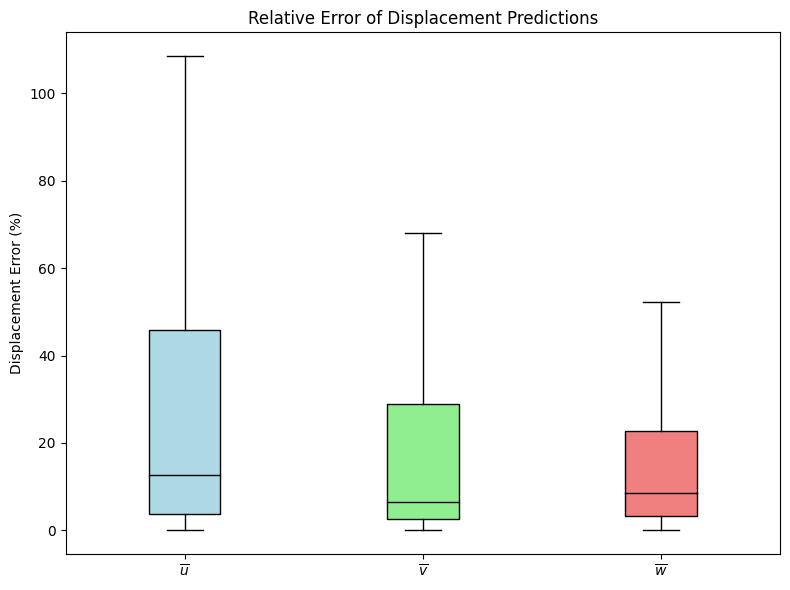

In [ ]:
# Relative error of displacement predictions

# Extract the data
predicted_data_u = predictions[0]
predicted_data_v = predictions[1]
predicted_data_w = predictions[2]

target_data_u = target_test_u
target_data_v = target_test_v
target_data_w = target_test_w

# Ensure all arrays have the same shape
predicted_data_u = predicted_data_u.reshape(-1)
predicted_data_v = predicted_data_v.reshape(-1)
predicted_data_w = predicted_data_w.reshape(-1)

target_data_u = target_data_u.reshape(-1)
target_data_v = target_data_v.reshape(-1)
target_data_w = target_data_w.reshape(-1)

# Create filters to exclude data points where either value is 0
non_zero_filter_u = (predicted_data_u != 0) & (target_data_u != 0)
non_zero_filter_v = (predicted_data_v != 0) & (target_data_v != 0)
non_zero_filter_w = (predicted_data_w != 0) & (target_data_w != 0)

# Apply the filters to both datasets
predicted_data_u = predicted_data_u[non_zero_filter_u]
predicted_data_v = predicted_data_v[non_zero_filter_v]
predicted_data_w = predicted_data_w[non_zero_filter_w]

target_data_u = target_data_u[non_zero_filter_u]
target_data_v = target_data_v[non_zero_filter_v]
target_data_w = target_data_w[non_zero_filter_w]

# Calculate relative errors
relative_errors_u = np.abs((predicted_data_u - target_data_u) / target_data_u)
relative_errors_v = np.abs((predicted_data_v - target_data_v) / target_data_v)
relative_errors_w = np.abs((predicted_data_w - target_data_w) / target_data_w)

# Create a box and whisker plot for all relative errors on the same plot
fig, ax = plt.subplots(figsize=(8, 6))

bp = ax.boxplot(
    [relative_errors_u*100,
        relative_errors_v*100, relative_errors_w*100],
    vert=True,
    showfliers=False,
    labels=['$\overline{\it{u}}$','$\overline{\it{v}}$','$\overline{\it{w}}$'],
    patch_artist=True,  # Color code the boxes
    medianprops={'color': 'black'}  # Set median line color to black
)

# Color code the boxes
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, color in zip(bp['boxes'], colors):
    patch.set_facecolor(color)

ax.set_ylabel('Displacement Error (%)')
ax.set_title('Relative Error of Displacement Predictions')

plt.tight_layout()
plt.show()


In [ ]:
# Distributions of the relative errors

mean = np.mean(relative_errors_u)
std_dev = np.std(relative_errors_u)
min_value = np.min(relative_errors_u)
max_value = np.max(relative_errors_u)
q1 = np.percentile(relative_errors_u, 25)
q3 = np.percentile(relative_errors_u, 75)
# Print the summary statistics
print("Mean Predicted U:", mean)
print("Standard Deviation Predicted U:", std_dev)
print("Min Value Predicted U:", min_value)
print("Max Value Predicted U:", max_value)
print("Q1:", q1)
print("Q3:", q3)
print("IQR:", q3-q1)

mean = np.mean(relative_errors_v)
std_dev = np.std(relative_errors_v)
min_value = np.min(relative_errors_v)
max_value = np.max(relative_errors_v)
q1 = np.percentile(relative_errors_v, 25)
q3 = np.percentile(relative_errors_v, 75)
# Print the summary statistics
print("Mean Predicted V:", mean)
print("Standard Deviation Predicted V:", std_dev)
print("Min Value Predicted V:", min_value)
print("Max Value Predicted V:", max_value)
print("Q1:", q1)
print("Q3:", q3)
print("IQR:", q3-q1)

mean = np.mean(relative_errors_w)
std_dev = np.std(relative_errors_w)
min_value = np.min(relative_errors_w)
max_value = np.max(relative_errors_w)
q1 = np.percentile(relative_errors_w, 25)
q3 = np.percentile(relative_errors_w, 75)
# Print the summary statistics
print("Mean Predicted W:", mean)
print("Standard Deviation Predicted W:", std_dev)
print("Min Value Predicted W:", min_value)
print("Max Value Predicted W:", max_value)
print("Q1:", q1)
print("Q3:", q3)
print("IQR:", q3-q1)

Mean Predicted U: 1.6526526
Standard Deviation Predicted U: 18.635515
Min Value Predicted U: 1.4449092e-05
Max Value Predicted U: 1167.7177
Q1: 0.03683854639530182
Q3: 0.4586031138896942
IQR: 0.4217645674943924
Mean Predicted V: 0.336182
Standard Deviation Predicted V: 1.6265202
Min Value Predicted V: 1.525863e-05
Max Value Predicted V: 79.82015
Q1: 0.02649945579469204
Q3: 0.2879655659198761
IQR: 0.26146611012518406
Mean Predicted W: 0.40857774
Standard Deviation Predicted W: 4.1466727
Min Value Predicted W: 4.956385e-06
Max Value Predicted W: 272.8657
Q1: 0.03158990293741226
Q3: 0.22796118259429932
IQR: 0.19637127965688705


In [ ]:
import scipy.stats as stats

# Perform Mann-Whitney U test
statistic, p_value = stats.mannwhitneyu(relative_errors_w, relative_errors_v, alternative='less')

# Set your significance level (alpha)
alpha = 0.05

# Compare the p-value to alpha to determine statistical significance
if p_value < alpha:
    print("Sample 1 has a smaller range than Sample 2.")
else:
    print("There is no evidence to suggest that Sample 1 has a smaller range than Sample 2.")

print(f"Mann-Whitney U statistic: {statistic}")
print(f"P-value: {p_value}")

There is no evidence to suggest that Sample 1 has a smaller range than Sample 2.
Mann-Whitney U statistic: 18731722.5
P-value: 0.978129797377893


In [ ]:
import scipy.stats as stats

# Perform Mann-Whitney U test
statistic, p_value = stats.mannwhitneyu(relative_errors_w, relative_errors_u, alternative='less')

# Set your significance level (alpha)
alpha = 0.05

# Compare the p-value to alpha to determine statistical significance
if p_value < alpha:
    print("Sample 1 has a smaller range than Sample 2.")
else:
    print("There is no evidence to suggest that Sample 1 has a smaller range than Sample 2.")

print(f"Mann-Whitney U statistic: {statistic}")
print(f"P-value: {p_value}")

Sample 1 has a smaller range than Sample 2.
Mann-Whitney U statistic: 15624676.5
P-value: 1.2814962065403462e-45


<h1>Clinical Images</h1>

In [ ]:
from tensorflow.keras.layers import Layer, Input, Conv2D, BatchNormalization, MaxPooling2D, Dropout, Flatten, Dense, Multiply
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow import keras

class BrightnessContrastBlurAugmentation(Layer):
   def __init__(self, brightness_range=(-0.1, 0.1), contrast_range=(0.95, 1.05), blur_range=(1, 12), **kwargs):
       super(BrightnessContrastBlurAugmentation, self).__init__(**kwargs)
       self.brightness_range = brightness_range
       self.contrast_range = contrast_range
       self.blur_range = blur_range

   def call(self, inputs, training=None):
       if training:
           # Randomly sample brightness, contrast, and blur values from the specified ranges
           brightness_factor = np.random.uniform(self.brightness_range[0], self.brightness_range[1])
           contrast_factor = np.random.uniform(self.contrast_range[0], self.contrast_range[1])
           blur_factor = np.random.randint(self.blur_range[0], self.blur_range[1] + 1)

           # Apply brightness and contrast adjustments
           augmented_images = tf.image.adjust_brightness(inputs, delta=brightness_factor)
           augmented_images = tf.image.adjust_contrast(augmented_images, contrast_factor)

           # Apply random blur
           augmented_images = tf.image.random_blur(augmented_images, (blur_factor, blur_factor))

           return augmented_images
       else:
           return inputs



def create_cnn(input_shape1, input_shape2, output_shape, dropout_rate, l2_lambda):
    input_layer1 = Input(shape=input_shape1)
    input_layer2 = Input(shape=input_shape2)

    x = input_layer1
    # Convolutional layers for the first image
    x = BatchNormalization()(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = BatchNormalization()(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(dropout_rate)(x)

    x = Flatten()(x)
    x = Dropout(dropout_rate)(x)
    x = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x = Dropout(dropout_rate)(x)
    x = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x = Dropout(dropout_rate)(x)

    x = BatchNormalization()(x)
    x_u = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x_u = Dropout(dropout_rate)(x_u)

    x_v = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x_v = Dropout(dropout_rate)(x_v)

    x_w = Dense(512, activation='relu', kernel_regularizer=l2(l2_lambda))(x)
    x_w = Dropout(dropout_rate)(x_w)

    x_u = Dense(output_shape[0] * output_shape[1], activation=None)(x_u)
    x_v = Dense(output_shape[0] * output_shape[1], activation=None)(x_v)
    x_w = Dense(output_shape[0] * output_shape[1], activation=None)(x_w)

    xm2 = Flatten()(input_layer2)
    output_layer_u = Multiply(name="out_u")([x_u, xm2])
    output_layer_v = Multiply(name="out_v")([x_v, xm2])
    output_layer_w = Multiply(name="out_w")([x_w, xm2])

    model = Model(inputs=[input_layer1, input_layer2], outputs=[output_layer_u, output_layer_v, output_layer_w])
    return model



# Define input shapes and output shape
input_shape1 = (input_train_1.shape[1], input_train_1.shape[2], 1)
input_shape2 = (input_train_2.shape[1], input_train_2.shape[2], 1)
output_shape = (target_train_u.shape[1], target_train_u.shape[2])

# Define regularisation and create the model
dropout_rate = 0.5
l2_lambda = 0.001
model = create_cnn(input_shape1, input_shape2, output_shape, dropout_rate, l2_lambda)
model.summary()

# Compile the model
model.compile(optimizer='adam', loss={'out_u': 'mean_squared_error', 'out_v': 'mean_squared_error', 'out_w': 'mean_squared_error'})

# Reshape input and target data
num_channels = 1
input_data1 = input_train_1.reshape(input_train_1.shape[0], input_train_1.shape[1], input_train_1.shape[2], num_channels)
input_data_val1 = input_val_1.reshape(input_val_1.shape[0], input_val_1.shape[1], input_val_1.shape[2], num_channels)
input_data2 = input_train_2.reshape(input_train_2.shape[0], input_train_2.shape[1], input_train_2.shape[2], num_channels)
input_data_val2 = input_val_2.reshape(input_val_2.shape[0], input_val_2.shape[1], input_val_2.shape[2], num_channels)
target_data_u = target_train_u.reshape(target_train_u.shape[0], -1)
target_data_val_u = target_val_u.reshape(target_val_u.shape[0], -1)
target_data_v = target_train_v.reshape(target_train_v.shape[0], -1)
target_data_val_v = target_val_v.reshape(target_val_v.shape[0], -1)
target_data_w = target_train_w.reshape(target_train_w.shape[0], -1)
target_data_val_w = target_val_w.reshape(target_val_w.shape[0], -1)

# Create data generators
def data_generator(input_data1, input_data2, target_data_1, target_data_2, target_data_3, batch_size):
    num_samples = input_data1.shape[0]
    while True:
        indices = np.random.permutation(num_samples)
        for start_idx in range(0, num_samples, batch_size):
            end_idx = min(start_idx + batch_size, num_samples)
            batch_indices = indices[start_idx:end_idx]
            batch_input1 = input_data1[batch_indices]
            batch_input2 = input_data2[batch_indices]
            batch_target1 = target_data_1[batch_indices]
            batch_target2 = target_data_2[batch_indices]
            batch_target3 = target_data_3[batch_indices]

            # Data augmentation
            augmented_batch_input1 = []
            for img in batch_input1:
                augmented_img = BrightnessContrastAugmentation()(img, training=True)
                augmented_batch_input1.append(augmented_img)
            augmented_batch_input1 = np.array(augmented_batch_input1)

            yield ([augmented_batch_input1, batch_input2], [batch_target1, batch_target2, batch_target3])

        # If the batch size exceeds the number of samples, resample the dataset
        if batch_size > num_samples:
            indices = np.random.permutation(num_samples)


# Train the model using the data generator
batch_size = 200
train_gen = data_generator(input_data1, input_data2, target_data_u, target_data_v, target_data_w, batch_size)
val_data = ([input_data_val1, input_data_val2], [target_data_val_u, target_data_val_v, target_data_val_w])

In [ ]:
# Create learning rate schedule and fit model

def lr_schedule(epoch, lr):
    if epoch == 0:
        lr=0.001
    if epoch == 300:
        lr=0.0001

    return lr

lr_scheduler = LearningRateScheduler(lr_schedule)

history = model.fit(
    train_gen,
    epochs=500,
    #steps_per_epoch=len(input_data1) // batch_size,
    steps_per_epoch=3,
    validation_data=val_data,
    callbacks=[lr_scheduler]
)

In [ ]:
model = tf.keras.models.load_model('/models/D2IM_trained_data_augmentation.h5')

Anterior-Posterior Slice

In [ ]:
folder_path = '/data/Clinical/AP/'

# Import Clinical Scan
scan = tiff.imread(os.path.join(folder_path, '551_t12t14_inputslice.tif'))
common_shape = (256, 256)
resized_img = zoom(scan, (common_shape[0] / scan.shape[0], common_shape[1] / scan.shape[1]), mode='nearest', order=0)
scan = np.array(resized_img)/255
scan = np.flipud(scan)
inputscan = scan.reshape(1, scan.shape[0], scan.shape[1], 1)

# Import clinical mask
mask = tiff.imread(os.path.join(folder_path, '551_t12t14_inputslice_mask.tif'))
common_shape = (20, 20)
resized_img = zoom(mask, (common_shape[0] / mask.shape[0], common_shape[1] / mask.shape[1]), mode='nearest', order=0)
mask = binary_dilation(np.array(resized_img))
inputmask = mask.reshape(1, mask.shape[0], mask.shape[1], 1)

# Import Rescaled High Res Scan
scan_HR_RE = tiff.imread(os.path.join(folder_path, 'S7_INT_UL_AP_50_0007_downscaled.tif'))
common_shape = (256, 256)
resized_img = zoom(scan_HR_RE, (common_shape[0] / scan_HR_RE.shape[0], common_shape[1] / scan_HR_RE.shape[1]), mode='nearest', order=0)
scan_HR_RE = np.array(resized_img)/255
inputscan_HR_RE = scan_HR_RE.reshape(1, scan_HR_RE.shape[0], scan_HR_RE.shape[1], 1)

# Import Hi res mask
mask_HR = tiff.imread(os.path.join(folder_path, 'S7_INT_UL_AP_50_0007_mask.tif'))
common_shape = (20, 20)
resized_img = zoom(mask_HR, (common_shape[0] / mask_HR.shape[0], common_shape[1] / mask_HR.shape[1]), mode='nearest', order=0)
mask_HR = binary_dilation(np.array(resized_img))
inputmask_HR = mask_HR.reshape(1, mask_HR.shape[0], mask_HR.shape[1], 1)

# Import Ground Truth
target = tiff.imread(os.path.join(folder_path, 'S7_INT_UL_AP_50_0007_GT.tif'))
common_shape = (20, 20)
resized_img = zoom(target, (common_shape[0] / target.shape[0], common_shape[1] / target.shape[1]), mode='nearest', order=0)
target = np.array(resized_img)
target[np.isnan(target)] = 0
target_GT = target.reshape(1, target.shape[0], target.shape[1], 1)

In [ ]:
# Make predictions using model
predictions = model.predict([inputscan, inputmask])
predictions_HR_RE = model.predict([inputscan_HR_RE, inputmask_HR])

1/1 [==============================] - 0s 117ms/step


/tmp/ipykernel_33/3302026376.py:14: RuntimeWarning: invalid value encountered in divide
  prediction_error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
/tmp/ipykernel_33/3302026376.py:16: RuntimeWarning: invalid value encountered in divide
  prediction_error_HR_RE = np.abs((target_image*msk-predicted_image_HR_RE*msk)/(target_image*msk))*100


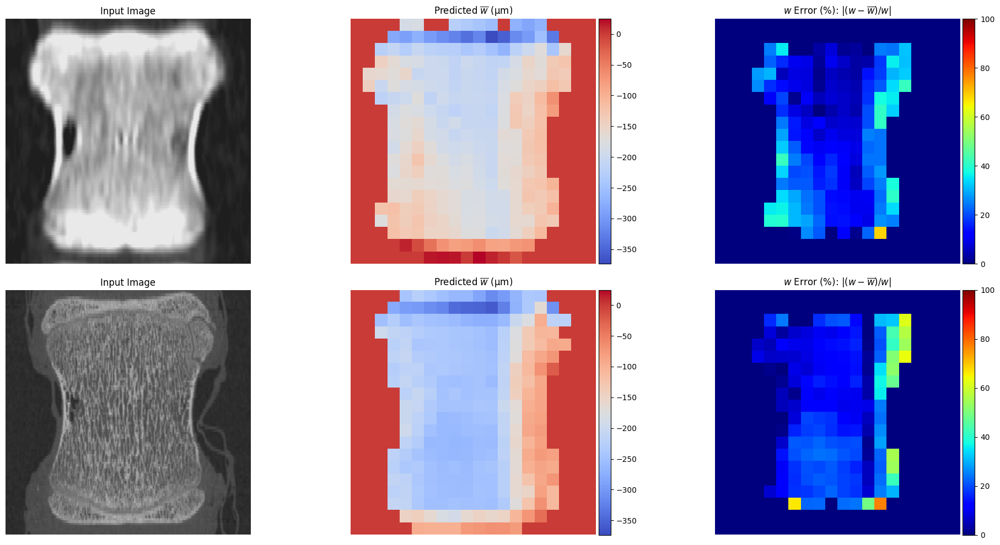

In [ ]:
vs = 39 # real voxel size um
ns = 50 # Node spacing

plt.figure(figsize=(20, 10))  # Adjust the figure size to accommodate three plots

predicted_image = (np.flipud(predictions[2][0].reshape(output_shape)))*vs
predicted_image_HR_RE = (np.flipud(predictions_HR_RE[2][0].reshape(output_shape)))*vs
target_image = np.flipud(target)*vs
min_d=np.array([predicted_image.min(),predicted_image_HR_RE.min()]).min()
max_d=np.array([predicted_image.max(),predicted_image_HR_RE.max()]).max()

msk = np.flipud(binary_erosion(inputmask.reshape(input_shape2[:2]), iterations = 2))

prediction_error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
prediction_error = np.nan_to_num(prediction_error, posinf=0, neginf=0)
prediction_error_HR_RE = np.abs((target_image*msk-predicted_image_HR_RE*msk)/(target_image*msk))*100
prediction_error_HR_RE = np.nan_to_num(prediction_error_HR_RE, posinf=0, neginf=0)

# Create a grid of subplots
gs = gridspec.GridSpec(2, 3, width_ratios=[1, 1.065, 1.065])

# Plot the input image
ax1 = plt.subplot(gs[0,0])  # Fourth subplot
im1= ax1.imshow(scan, cmap='gray', vmin=0, vmax=1)
ax1.set_title("Input Image")
ax1.axis('off')

# Plot the predicted output
ax2 = plt.subplot(gs[0,1], sharey=ax3)  # Second subplot, sharing y-axis with the first subplot
im2 = ax2.imshow(predicted_image, cmap='coolwarm', vmin=min_d, vmax=max_d)
ax2.set_title("Predicted $\overline{w}$ (μm)")

#shared axes
divider = make_axes_locatable(ax2)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax2.axis('off')

ax3 = plt.subplot(gs[0,2])  # First subplot
im3 = ax3.imshow(prediction_error, cmap='jet', vmin=0, vmax=100)
ax3.set_title("$w$ Error (%): $|(w-\overline{w})/w|$")
ax3.axis('off')
divider = make_axes_locatable(ax3)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax3.axis('off')

###### Row 2

# Plot the input image
ax2 = plt.subplot(gs[1,0])  # Fourth subplot
input_image = np.flipud(inputscan_HR_RE[0])
im2 = ax2.imshow(input_image, cmap='gray', vmin=0, vmax=1)
ax2.set_title("Input Image")
ax2.axis('off')

# Plot the predicted output
ax2 = plt.subplot(gs[1,1], sharey=ax3)  # Second subplot, sharing y-axis with the first subplot
im2 = ax2.imshow(predicted_image_HR_RE, cmap='coolwarm', vmin=min_d, vmax=max_d)
ax2.set_title("Predicted $\overline{w}$ (μm)")

#shared axes
divider = make_axes_locatable(ax2)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax2.axis('off')

ax3 = plt.subplot(gs[1,2])  # First subplot
im3 = ax3.imshow(prediction_error_HR_RE, cmap='jet', vmin=0, vmax=100)
ax3.set_title("$w$ Error (%): $|(w-\overline{w})/w|$")
ax3.axis('off')
divider = make_axes_locatable(ax3)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax3.axis('off')

plt.tight_layout()  # Ensure plots don't overlap
plt.show()

Medial-Lateral Slice

In [ ]:
folder_path = '/data/Clinical/ML/'

# Import Clinical Scan
scan = tiff.imread(os.path.join(folder_path, '544_t8t10_inputslice.tif'))
common_shape = (256, 256)
resized_img = zoom(scan, (common_shape[0] / scan.shape[0], common_shape[1] / scan.shape[1]), mode='nearest', order=0)
scan = np.array(resized_img)/255
scan = np.flipud(scan)
inputscan = scan.reshape(1, scan.shape[0], scan.shape[1], 1)

# Import clinical mask
mask = tiff.imread(os.path.join(folder_path, '544_t8t10_inputslice_mask.tif'))
common_shape = (20, 20)
resized_img = zoom(mask, (common_shape[0] / mask.shape[0], common_shape[1] / mask.shape[1]), mode='nearest', order=0)
mask = binary_dilation(np.array(resized_img))
inputmask = mask.reshape(1, mask.shape[0], mask.shape[1], 1)

# Import Rescaled High Res Scan
scan_HR_RE = tiff.imread(os.path.join(folder_path, 'S1_INT_UL_ML_50_0015_downscaled.tif'))
common_shape = (256, 256)
resized_img = zoom(scan_HR_RE, (common_shape[0] / scan_HR_RE.shape[0], common_shape[1] / scan_HR_RE.shape[1]), mode='nearest', order=0)
scan_HR_RE = np.array(resized_img)/255
inputscan_HR_RE = scan_HR_RE.reshape(1, scan_HR_RE.shape[0], scan_HR_RE.shape[1], 1)

# Import Hi res mask
mask_HR = tiff.imread(os.path.join(folder_path, 'S1_INT_UL_ML_50_0015_mask.tif'))
common_shape = (20, 20)
resized_img = zoom(mask_HR, (common_shape[0] / mask_HR.shape[0], common_shape[1] / mask_HR.shape[1]), mode='nearest', order=0)
mask_HR = binary_dilation(np.array(resized_img))
inputmask_HR = mask_HR.reshape(1, mask_HR.shape[0], mask_HR.shape[1], 1)

# Import Ground Truth
target = tiff.imread(os.path.join(folder_path, 'S1_INT_UL_ML_50_0015_GT.tif'))
common_shape = (20, 20)
resized_img = zoom(target, (common_shape[0] / target.shape[0], common_shape[1] / target.shape[1]), mode='nearest', order=0)
target = np.array(resized_img)
target[np.isnan(target)] = 0
target_GT = target.reshape(1, target.shape[0], target.shape[1], 1)

In [ ]:
# Make predictions using model
predictions = model.predict([inputscan, inputmask])
predictions_HR_RE = model.predict([inputscan_HR_RE, inputmask_HR])

1/1 [==============================] - 0s 116ms/step


/tmp/ipykernel_33/3302026376.py:14: RuntimeWarning: invalid value encountered in divide
  prediction_error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
/tmp/ipykernel_33/3302026376.py:16: RuntimeWarning: invalid value encountered in divide
  prediction_error_HR_RE = np.abs((target_image*msk-predicted_image_HR_RE*msk)/(target_image*msk))*100


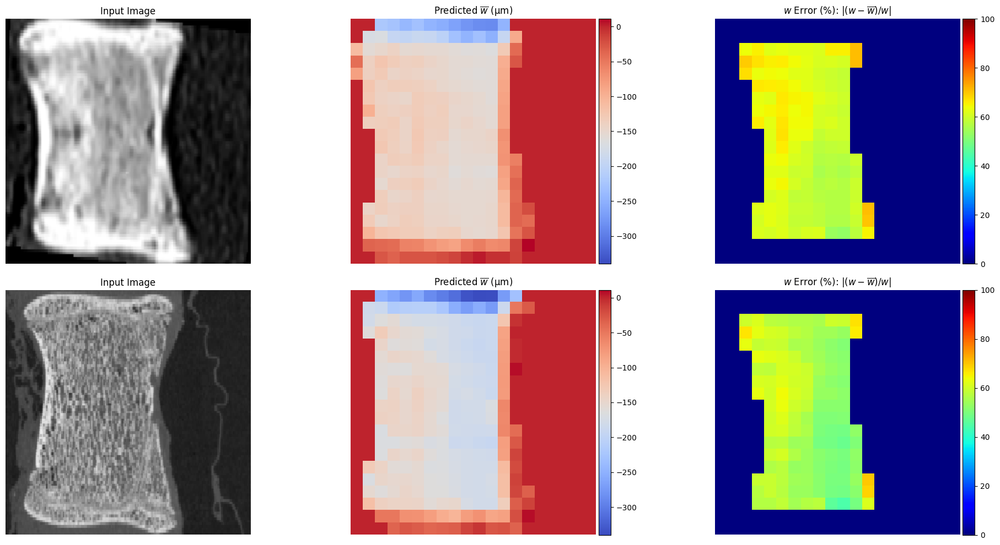

In [ ]:
vs = 39 # real voxel size um
ns = 50 # Node spacing

plt.figure(figsize=(20, 10))  # Adjust the figure size to accommodate three plots

predicted_image = (np.flipud(predictions[2][0].reshape(output_shape)))*vs
predicted_image_HR_RE = (np.flipud(predictions_HR_RE[2][0].reshape(output_shape)))*vs
target_image = np.flipud(target)*vs
min_d=np.array([predicted_image.min(),predicted_image_HR_RE.min()]).min()
max_d=np.array([predicted_image.max(),predicted_image_HR_RE.max()]).max()

msk = np.flipud(binary_erosion(inputmask.reshape(input_shape2[:2]), iterations = 2))

prediction_error = np.abs((target_image*msk-predicted_image*msk)/(target_image*msk))*100
prediction_error = np.nan_to_num(prediction_error, posinf=0, neginf=0)
prediction_error_HR_RE = np.abs((target_image*msk-predicted_image_HR_RE*msk)/(target_image*msk))*100
prediction_error_HR_RE = np.nan_to_num(prediction_error_HR_RE, posinf=0, neginf=0)

# Create a grid of subplots
gs = gridspec.GridSpec(2, 3, width_ratios=[1, 1.065, 1.065])

# Plot the input image
ax1 = plt.subplot(gs[0,0])  # Fourth subplot
im1= ax1.imshow(scan, cmap='gray', vmin=0, vmax=1)
ax1.set_title("Input Image")
ax1.axis('off')

# Plot the predicted output
ax2 = plt.subplot(gs[0,1], sharey=ax3)  # Second subplot, sharing y-axis with the first subplot
im2 = ax2.imshow(predicted_image, cmap='coolwarm', vmin=min_d, vmax=max_d)
ax2.set_title("Predicted $\overline{w}$ (μm)")

#shared axes
divider = make_axes_locatable(ax2)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax2.axis('off')

ax3 = plt.subplot(gs[0,2])  # First subplot
im3 = ax3.imshow(prediction_error, cmap='jet', vmin=0, vmax=100)
ax3.set_title("$w$ Error (%): $|(w-\overline{w})/w|$")
ax3.axis('off')
divider = make_axes_locatable(ax3)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax3.axis('off')

###### Row 2

# Plot the input image
ax2 = plt.subplot(gs[1,0])  # Fourth subplot
input_image = np.flipud(inputscan_HR_RE[0])
im2 = ax2.imshow(input_image, cmap='gray', vmin=0, vmax=1)
ax2.set_title("Input Image")
ax2.axis('off')

# Plot the predicted output
ax2 = plt.subplot(gs[1,1], sharey=ax3)  # Second subplot, sharing y-axis with the first subplot
im2 = ax2.imshow(predicted_image_HR_RE, cmap='coolwarm', vmin=min_d, vmax=max_d)
ax2.set_title("Predicted $\overline{w}$ (μm)")

#shared axes
divider = make_axes_locatable(ax2)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im2, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax2.axis('off')

ax3 = plt.subplot(gs[1,2])  # First subplot
im3 = ax3.imshow(prediction_error_HR_RE, cmap='jet', vmin=0, vmax=100)
ax3.set_title("$w$ Error (%): $|(w-\overline{w})/w|$")
ax3.axis('off')
divider = make_axes_locatable(ax3)
cax = divider.append_axes("right", size="5%", pad=0.05)  # Adjust the size and padding
plt.colorbar(im3, cax=cax)  # Add colorbar to the right side
cax.yaxis.set_ticks_position('right')  # Move the colorbar ticks to the left side
ax3.axis('off')

plt.tight_layout()  # Ensure plots don't overlap
plt.show()